In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

/home/ubuntu/anaconda3/envs/retrieval/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Generator

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

# Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels of the output image, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        
        return disc_pred.view(len(disc_pred), -1)

In [4]:
import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    return F.one_hot(labels, n_classes)

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


In [8]:
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    combined = torch.cat([x, y], dim=1)

    return combined

In [9]:
assert tuple(combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5)).shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


# Training

In [10]:
mnist_shape = (1, 28, 28)
n_classes = 10

In [11]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

In [30]:
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    
    return generator_input_dim, discriminator_im_chan

In [31]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [32]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

  1%|          | 5/469 [00:00<00:43, 10.76it/s]

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!


  6%|▌         | 28/469 [00:00<00:12, 34.77it/s]

Step 500: Generator loss: 1.9038886560201644, discriminator loss: 0.3048877254351974


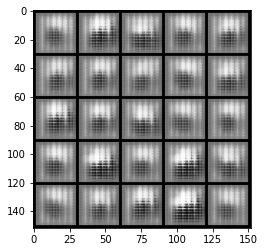

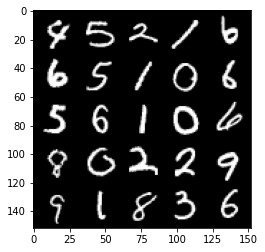

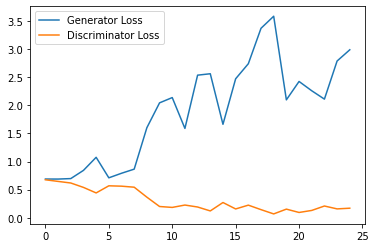

 13%|█▎        | 60/469 [00:01<00:12, 33.97it/s]

Step 1000: Generator loss: 3.653256122350693, discriminator loss: 0.1134158927295357


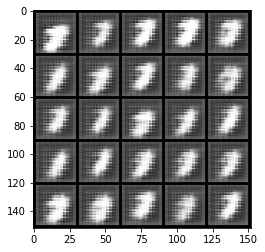

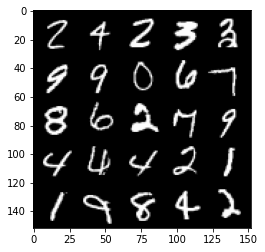

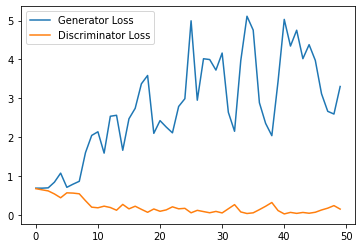

 19%|█▉        | 91/469 [00:02<00:12, 30.00it/s]

Step 1500: Generator loss: 4.173013332366943, discriminator loss: 0.08637351416796446


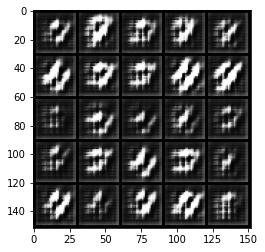

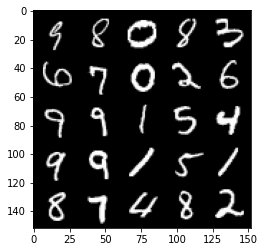

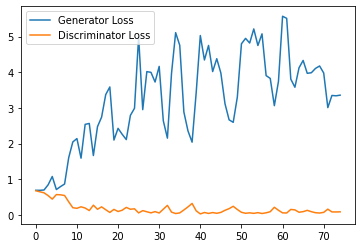

 26%|██▌       | 123/469 [00:03<00:10, 34.43it/s]

Step 2000: Generator loss: 3.6032985787391665, discriminator loss: 0.09421882965415716


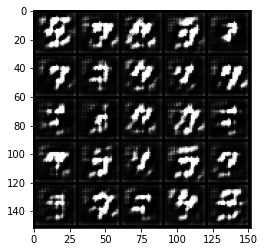

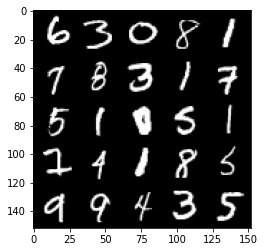

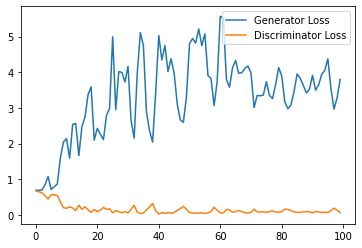

 33%|███▎      | 154/469 [00:04<00:09, 33.27it/s]

Step 2500: Generator loss: 2.7110803105831147, discriminator loss: 0.2095231984257698


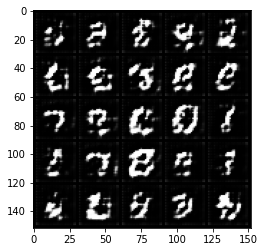

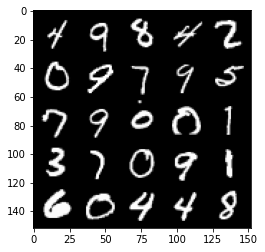

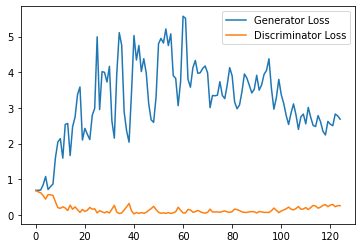

 39%|███▉      | 184/469 [00:05<00:08, 33.25it/s]

Step 3000: Generator loss: 2.335796375274658, discriminator loss: 0.3190161040276289


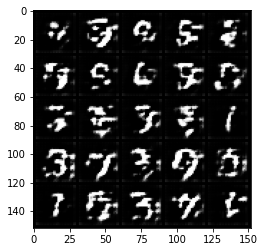

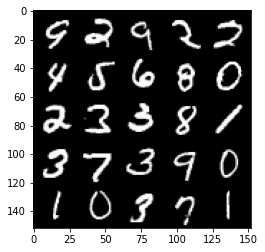

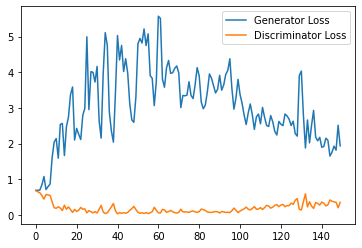

 46%|████▋     | 217/469 [00:06<00:07, 33.92it/s]

Step 3500: Generator loss: 2.0621727409362793, discriminator loss: 0.34282251274585723


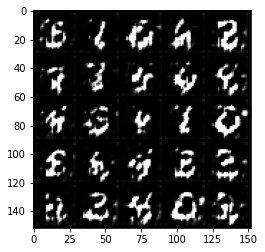

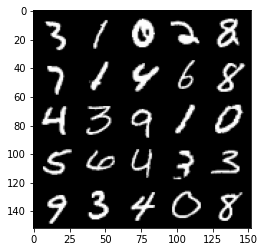

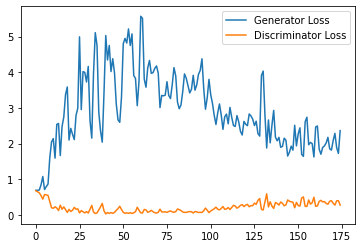

 52%|█████▏    | 246/469 [00:07<00:06, 33.18it/s]

Step 4000: Generator loss: 2.0468038067817687, discriminator loss: 0.3559500841796398


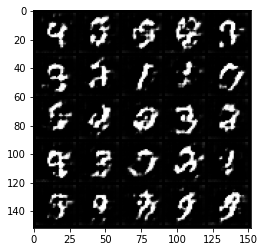

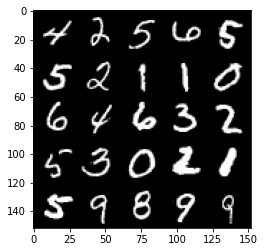

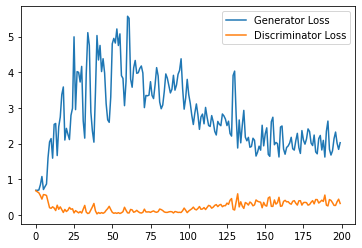

 59%|█████▉    | 279/469 [00:08<00:05, 36.80it/s]

Step 4500: Generator loss: 1.9526211392879487, discriminator loss: 0.37474622803926466


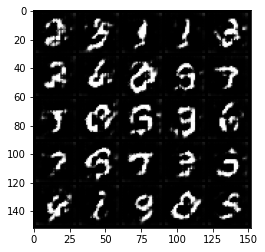

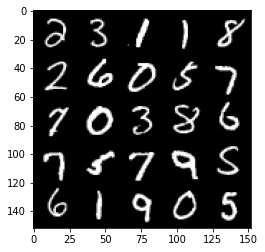

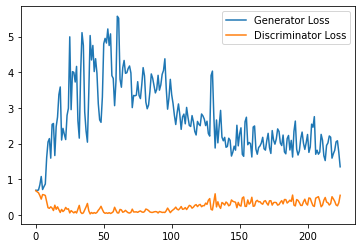

 66%|██████▌   | 308/469 [00:09<00:04, 33.60it/s]

Step 5000: Generator loss: 1.7647330207824707, discriminator loss: 0.3793917307257652


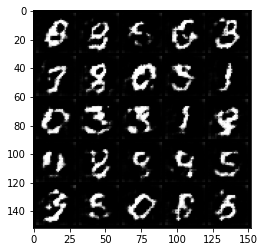

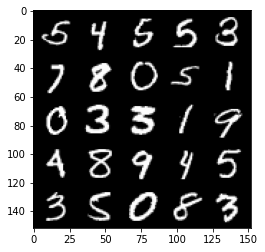

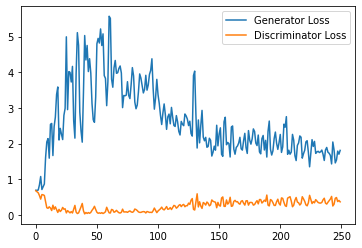

 72%|███████▏  | 339/469 [00:10<00:03, 37.39it/s]

Step 5500: Generator loss: 1.6324727466106415, discriminator loss: 0.4347896454036236


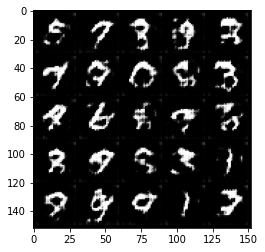

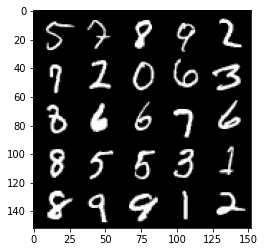

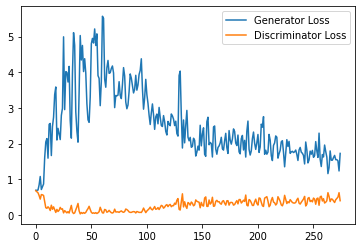

 79%|███████▊  | 369/469 [00:10<00:03, 33.14it/s]

Step 6000: Generator loss: 1.569808453321457, discriminator loss: 0.44680952712893485


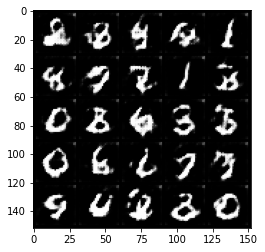

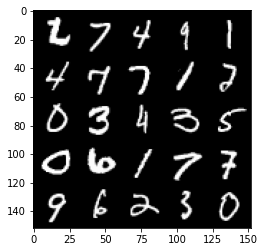

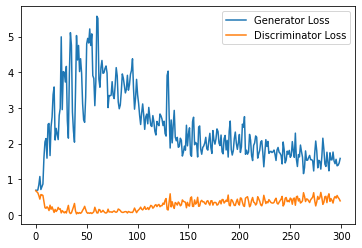

 86%|████████▌ | 403/469 [00:12<00:01, 35.99it/s]

Step 6500: Generator loss: 1.5333935899734497, discriminator loss: 0.4611229636371136


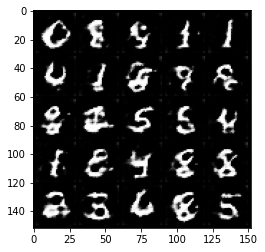

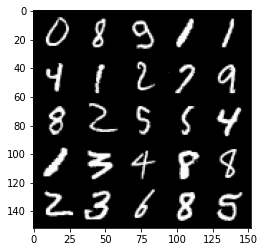

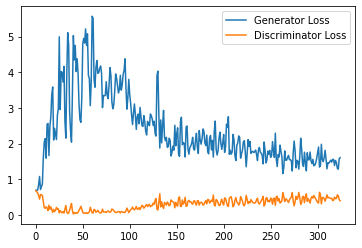

 93%|█████████▎| 434/469 [00:13<00:01, 33.83it/s]

Step 7000: Generator loss: 1.4584585816860198, discriminator loss: 0.47809260761737826


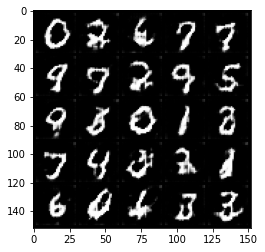

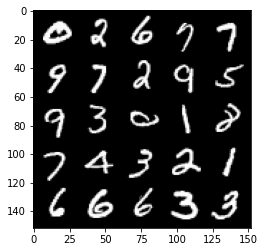

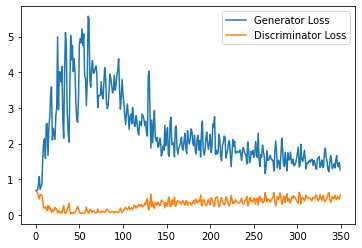

 99%|█████████▉| 465/469 [00:14<00:00, 32.61it/s]

Step 7500: Generator loss: 1.39779510140419, discriminator loss: 0.5051331798434258


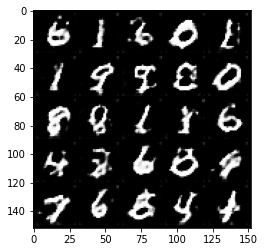

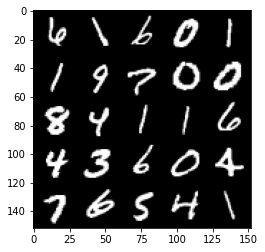

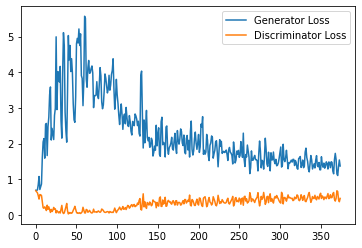

  5%|▌         | 24/469 [00:00<00:13, 33.79it/s]

Step 8000: Generator loss: 1.2241400406360625, discriminator loss: 0.5216578339934349


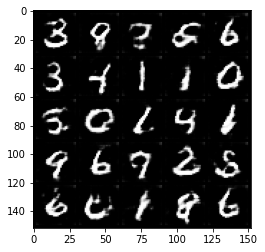

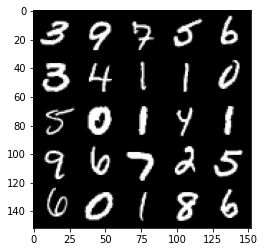

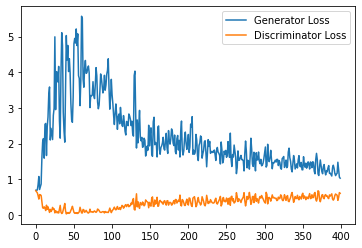

 12%|█▏        | 56/469 [00:02<00:15, 26.67it/s]

Step 8500: Generator loss: 1.1871056118011474, discriminator loss: 0.5382673255205155


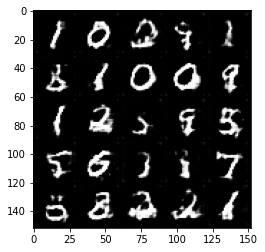

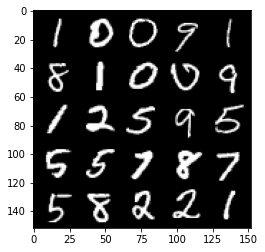

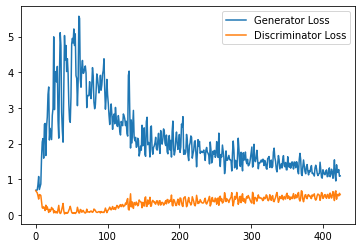

 19%|█▉        | 89/469 [00:02<00:11, 33.03it/s]

Step 9000: Generator loss: 1.280583104133606, discriminator loss: 0.5452271898388863


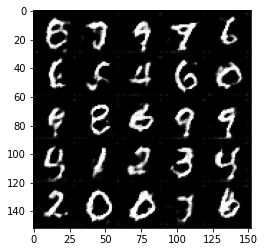

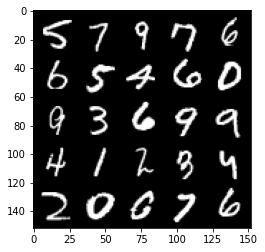

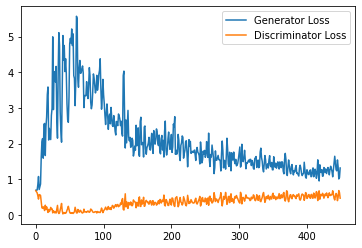

 25%|██▌       | 118/469 [00:03<00:10, 32.98it/s]

Step 9500: Generator loss: 1.108381772518158, discriminator loss: 0.5626185837984085


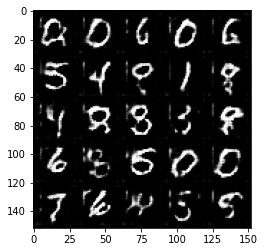

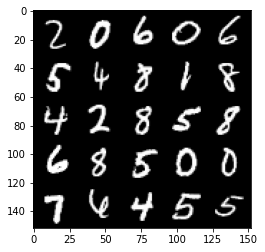

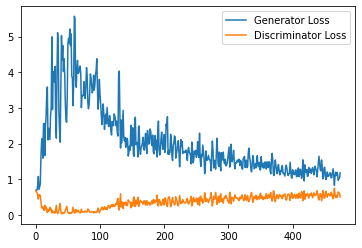

 32%|███▏      | 148/469 [00:04<00:09, 33.84it/s]

Step 10000: Generator loss: 1.1591784875392914, discriminator loss: 0.5674510706067085


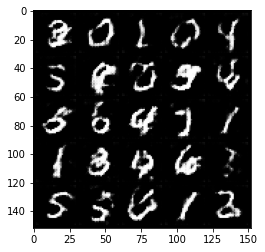

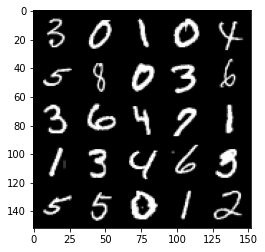

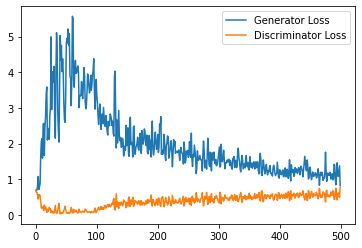

 38%|███▊      | 179/469 [00:05<00:07, 37.39it/s]

Step 10500: Generator loss: 1.0892006653547286, discriminator loss: 0.5719484839439392


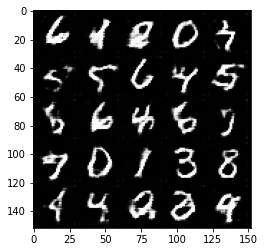

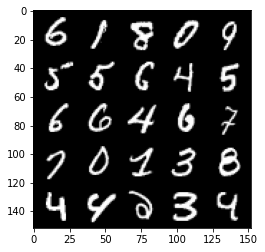

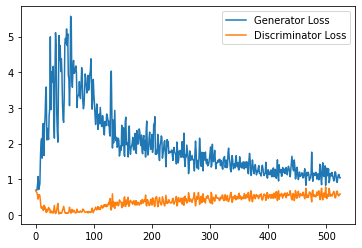

 45%|████▌     | 212/469 [00:06<00:07, 32.43it/s]

Step 11000: Generator loss: 1.09353176176548, discriminator loss: 0.5743394860029221


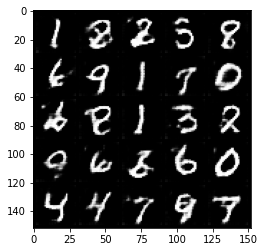

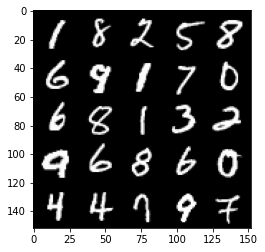

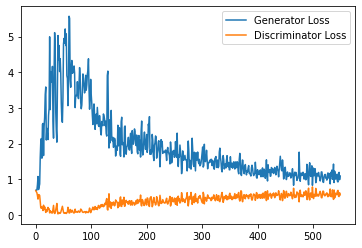

 52%|█████▏    | 244/469 [00:07<00:06, 32.38it/s]

Step 11500: Generator loss: 1.0962820198535919, discriminator loss: 0.5798283857703209


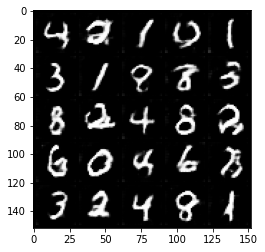

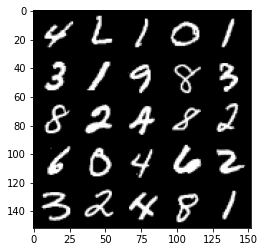

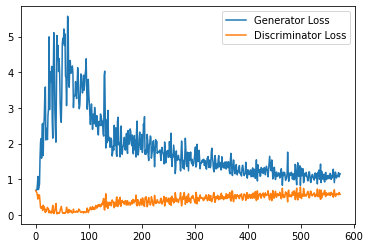

 58%|█████▊    | 274/469 [00:08<00:06, 29.66it/s]

Step 12000: Generator loss: 1.0818445140123367, discriminator loss: 0.5854328190088272


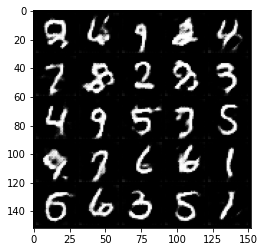

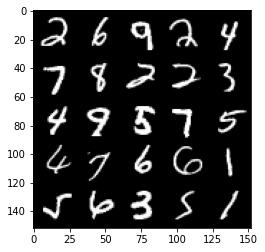

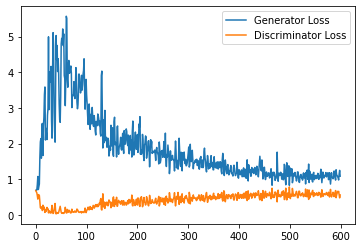

 65%|██████▍   | 304/469 [00:09<00:04, 33.50it/s]

Step 12500: Generator loss: 1.0283625417947768, discriminator loss: 0.5897366806864739


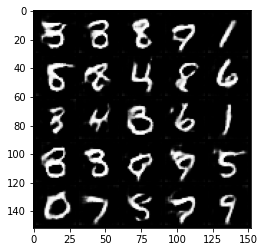

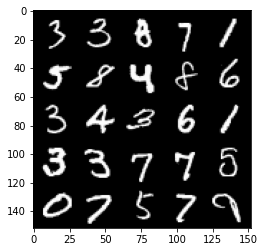

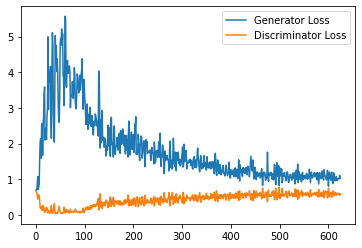

 72%|███████▏  | 337/469 [00:10<00:03, 37.48it/s]

Step 13000: Generator loss: 1.0212519730329515, discriminator loss: 0.5890071051120758


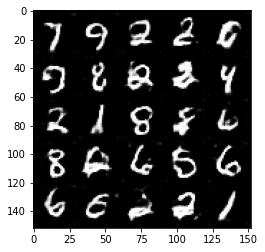

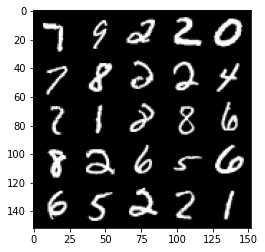

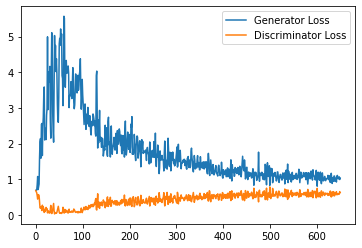

 78%|███████▊  | 366/469 [00:11<00:02, 34.46it/s]

Step 13500: Generator loss: 1.0709997948408128, discriminator loss: 0.5830631359219551


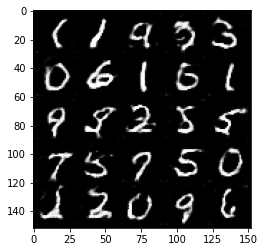

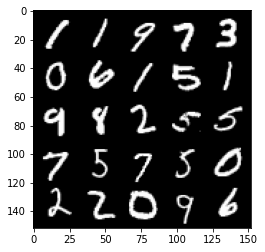

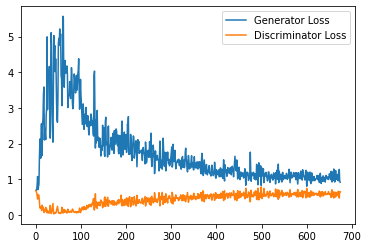

 85%|████████▍ | 398/469 [00:11<00:01, 39.71it/s]

Step 14000: Generator loss: 1.082069157600403, discriminator loss: 0.5837948291301728


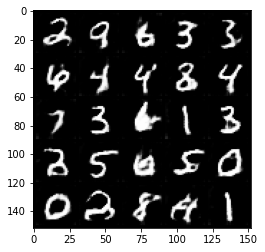

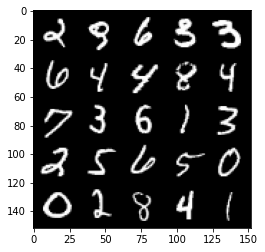

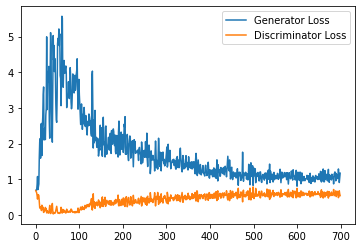

 91%|█████████▏| 428/469 [00:12<00:01, 35.26it/s]

Step 14500: Generator loss: 1.03230970788002, discriminator loss: 0.5857695510387421


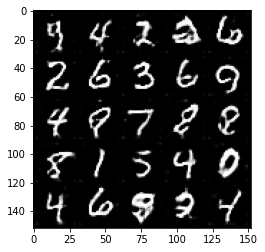

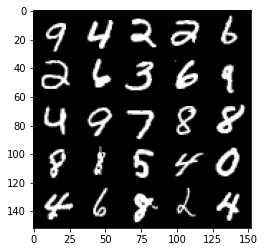

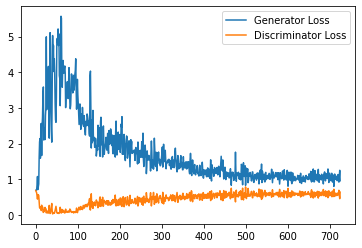

 98%|█████████▊| 460/469 [00:13<00:00, 33.35it/s]

Step 15000: Generator loss: 1.050907022714615, discriminator loss: 0.5868453709483147


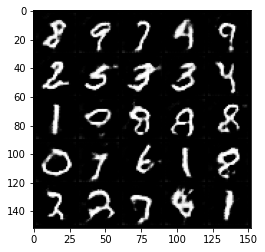

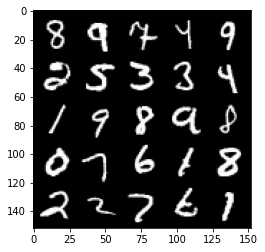

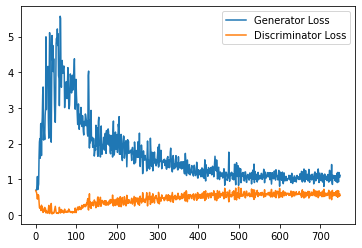

  4%|▍         | 20/469 [00:00<00:13, 34.20it/s]

Step 15500: Generator loss: 1.018880317568779, discriminator loss: 0.5890570976734162


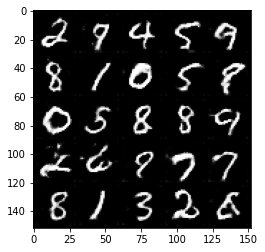

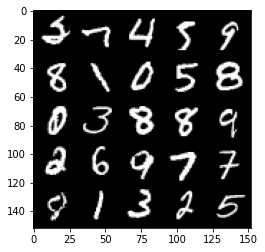

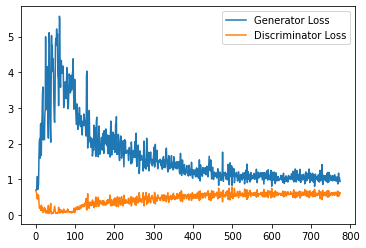

 11%|█         | 52/469 [00:01<00:13, 31.06it/s]

Step 16000: Generator loss: 1.0360545930862426, discriminator loss: 0.5832117792367936


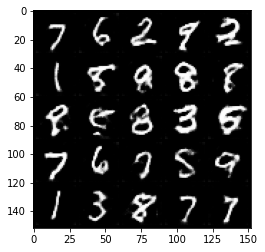

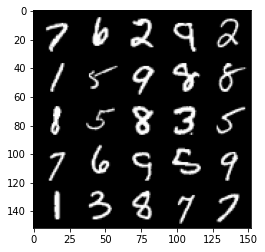

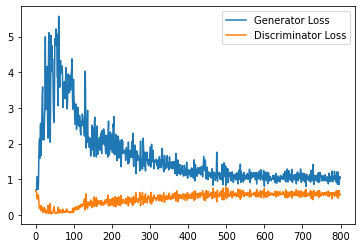

 18%|█▊        | 84/469 [00:02<00:11, 33.05it/s]

Step 16500: Generator loss: 1.0133835207223891, discriminator loss: 0.5898446031212806


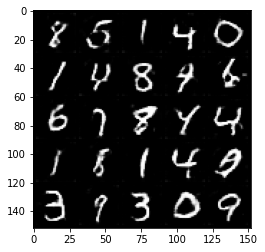

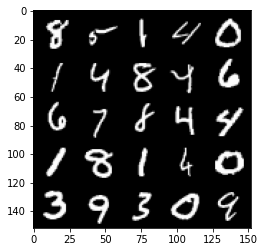

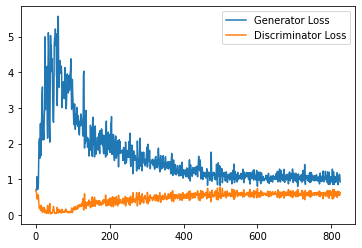

 25%|██▍       | 116/469 [00:03<00:10, 33.27it/s]

Step 17000: Generator loss: 1.0207105516195296, discriminator loss: 0.5930542100667954


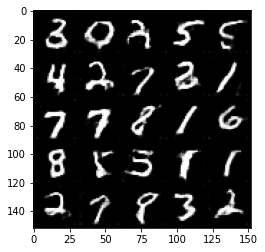

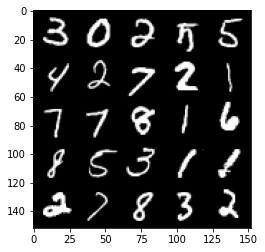

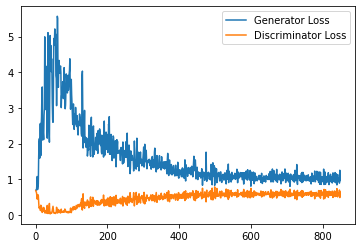

 31%|███▏      | 147/469 [00:04<00:09, 33.58it/s]

Step 17500: Generator loss: 1.0285059247016908, discriminator loss: 0.5929541192650795


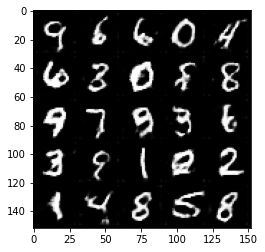

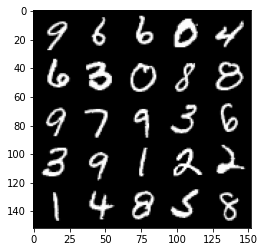

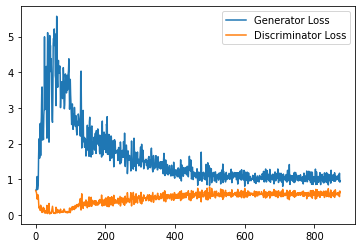

 38%|███▊      | 176/469 [00:05<00:08, 34.16it/s]

Step 18000: Generator loss: 1.0269612253904343, discriminator loss: 0.5887558106780052


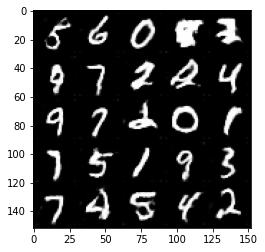

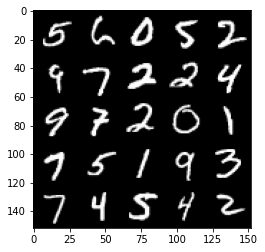

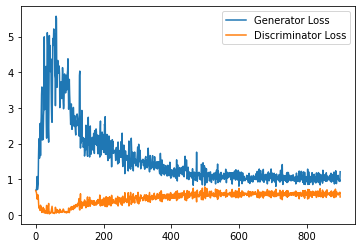

 45%|████▍     | 209/469 [00:06<00:08, 31.81it/s]

Step 18500: Generator loss: 0.9793693581819535, discriminator loss: 0.5943398036956787


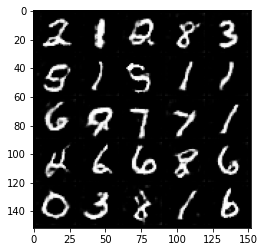

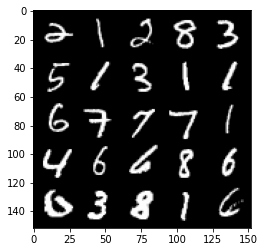

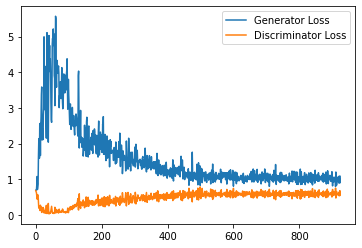

 51%|█████     | 240/469 [00:07<00:06, 37.03it/s]

Step 19000: Generator loss: 0.9993979693651199, discriminator loss: 0.5938239734768868


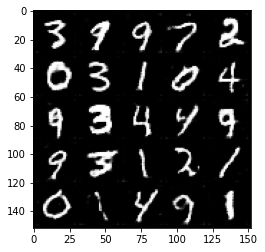

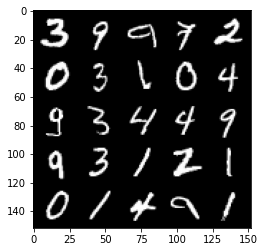

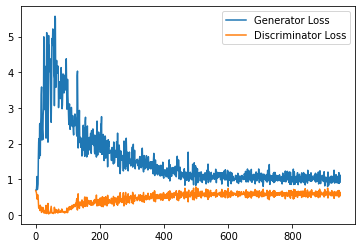

 57%|█████▋    | 269/469 [00:08<00:06, 31.50it/s]

Step 19500: Generator loss: 1.0223955864906311, discriminator loss: 0.5941019333004951


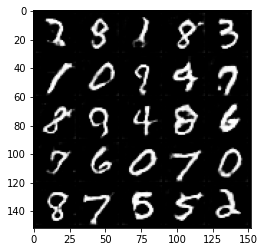

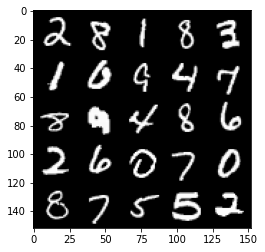

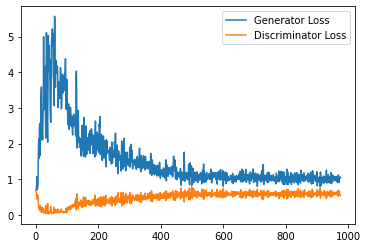

 64%|██████▍   | 301/469 [00:09<00:04, 34.62it/s]

Step 20000: Generator loss: 0.987453719496727, discriminator loss: 0.5968462758660317


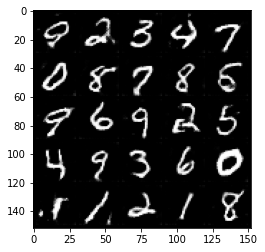

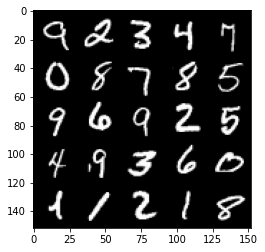

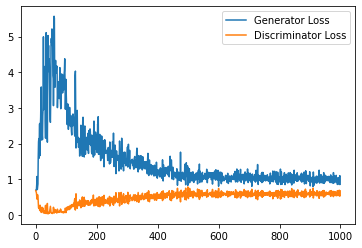

 70%|███████   | 330/469 [00:09<00:04, 34.13it/s]

Step 20500: Generator loss: 0.9776542750597, discriminator loss: 0.5889793590903282


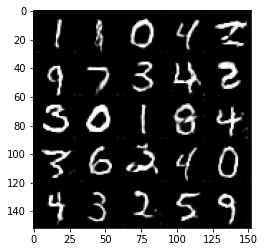

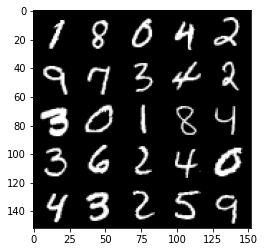

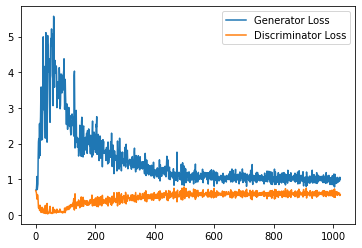

 77%|███████▋  | 363/469 [00:11<00:03, 33.27it/s]

Step 21000: Generator loss: 0.9960543781518936, discriminator loss: 0.6022492283582688


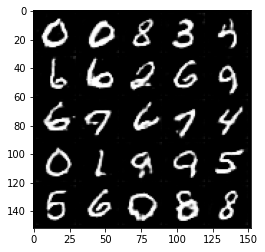

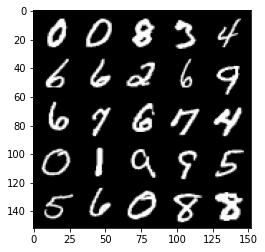

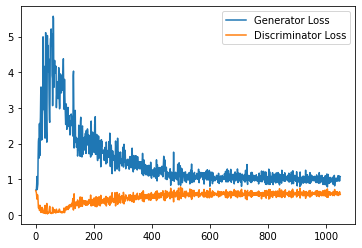

 84%|████████▎ | 392/469 [00:11<00:02, 33.99it/s]

Step 21500: Generator loss: 1.0106086738109588, discriminator loss: 0.5979953367114067


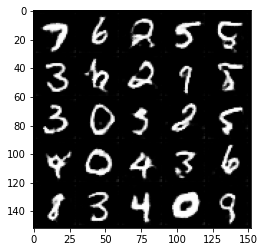

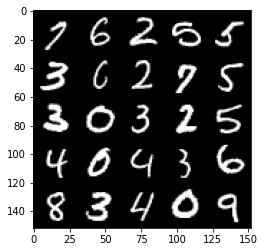

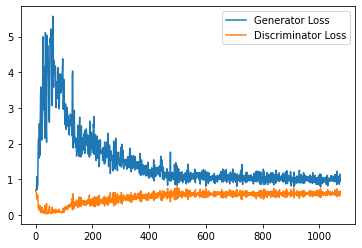

 91%|█████████ | 426/469 [00:12<00:01, 32.58it/s]

Step 22000: Generator loss: 0.9796221433877945, discriminator loss: 0.6028807551264763


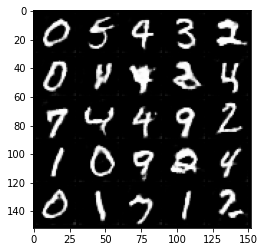

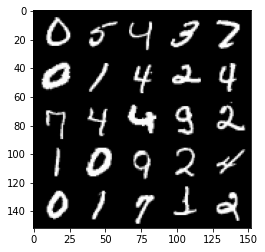

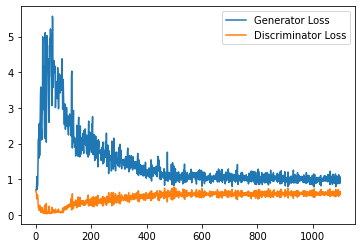

 97%|█████████▋| 456/469 [00:13<00:00, 34.01it/s]

Step 22500: Generator loss: 0.9928849436044693, discriminator loss: 0.6011739476323128


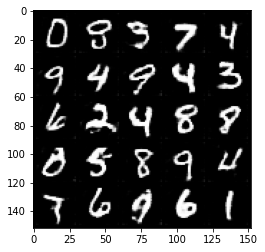

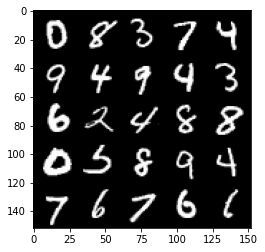

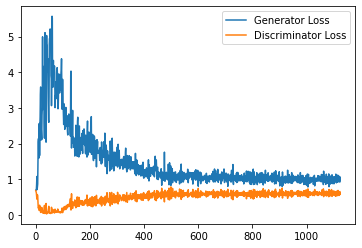

  3%|▎         | 16/469 [00:00<00:14, 31.32it/s]

Step 23000: Generator loss: 0.967020676612854, discriminator loss: 0.5996365296244621


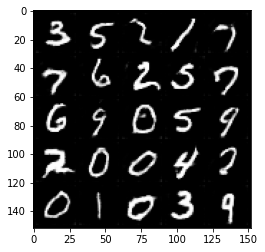

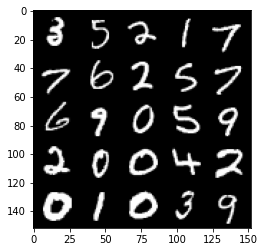

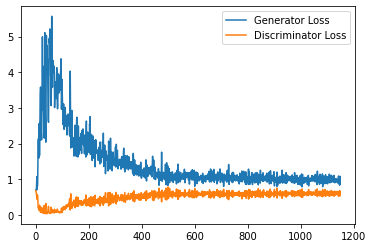

 10%|█         | 48/469 [00:01<00:12, 33.43it/s]

Step 23500: Generator loss: 0.9629452365636826, discriminator loss: 0.6019861119389533


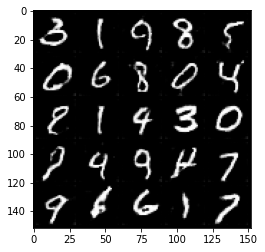

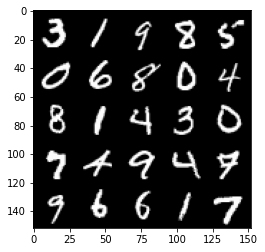

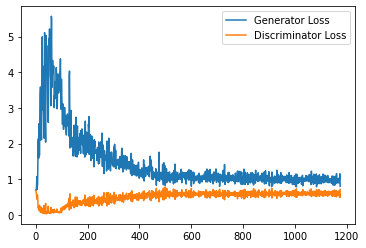

 16%|█▋        | 77/469 [00:02<00:10, 36.28it/s]

Step 24000: Generator loss: 0.9718365545272827, discriminator loss: 0.5985497180223465


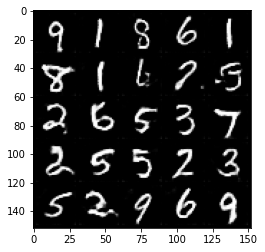

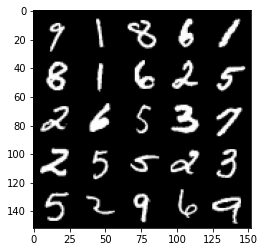

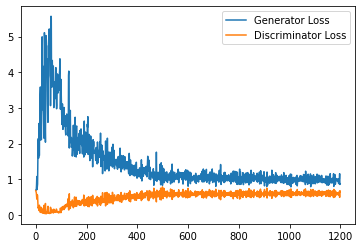

 24%|██▍       | 112/469 [00:03<00:11, 32.18it/s]

Step 24500: Generator loss: 0.9583556921482086, discriminator loss: 0.6007025363445282


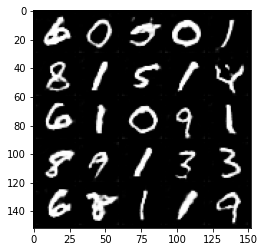

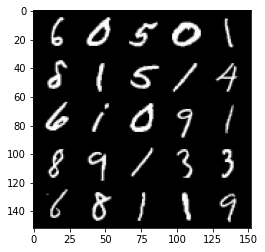

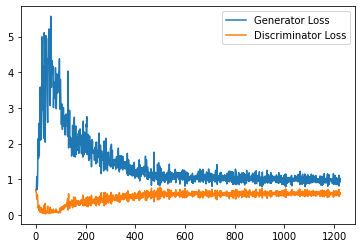

 30%|███       | 143/469 [00:04<00:09, 33.25it/s]

Step 25000: Generator loss: 0.9718164739608764, discriminator loss: 0.5984550350308419


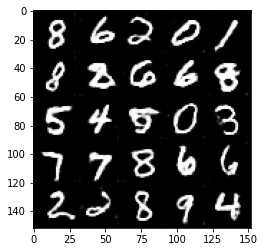

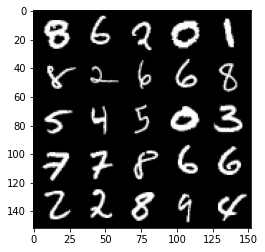

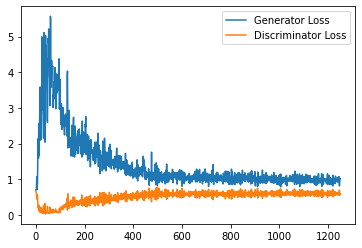

 37%|███▋      | 172/469 [00:05<00:09, 31.67it/s]

Step 25500: Generator loss: 0.9807638971805572, discriminator loss: 0.5979535591602325


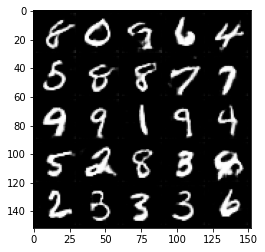

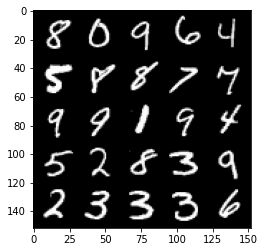

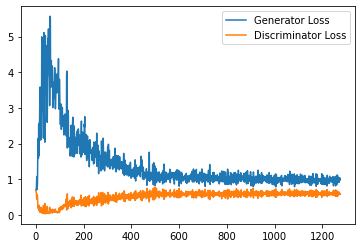

 43%|████▎     | 204/469 [00:06<00:08, 32.75it/s]

Step 26000: Generator loss: 0.9739225469827651, discriminator loss: 0.6036553737521172


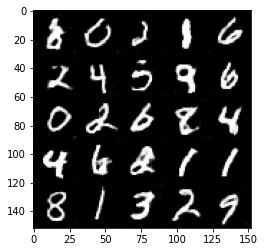

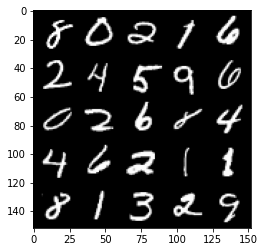

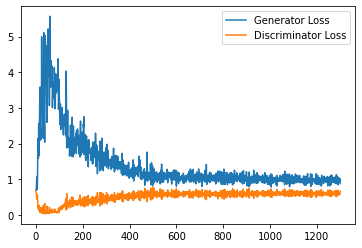

 50%|█████     | 235/469 [00:07<00:07, 31.78it/s]

Step 26500: Generator loss: 0.9885394237041474, discriminator loss: 0.5932964739203453


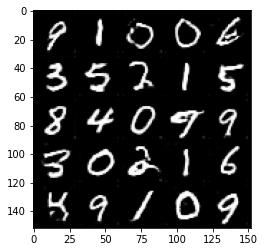

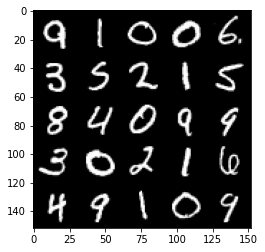

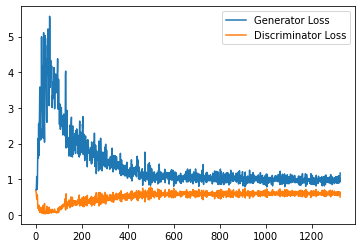

 56%|█████▋    | 264/469 [00:07<00:06, 33.27it/s]

Step 27000: Generator loss: 0.988171643614769, discriminator loss: 0.5972618948221207


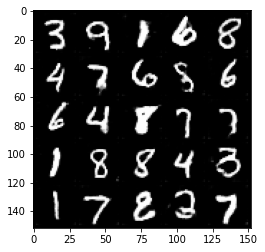

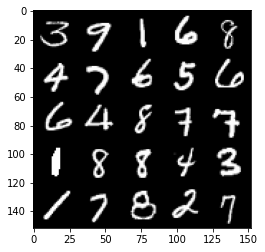

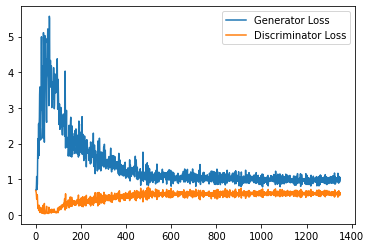

 63%|██████▎   | 297/469 [00:08<00:05, 33.66it/s]

Step 27500: Generator loss: 1.004050825715065, discriminator loss: 0.5950265803933144


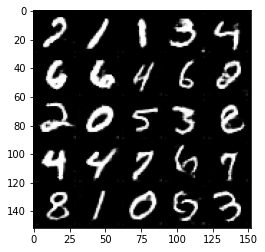

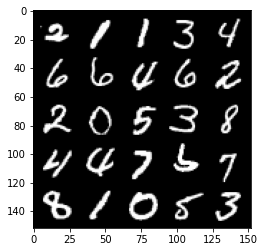

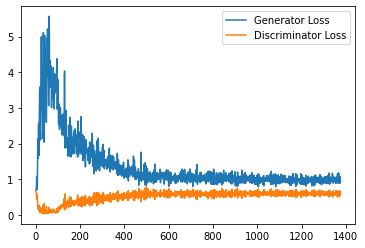

 70%|███████   | 329/469 [00:09<00:03, 35.58it/s]

Step 28000: Generator loss: 0.9884871740341187, discriminator loss: 0.5933201327323914


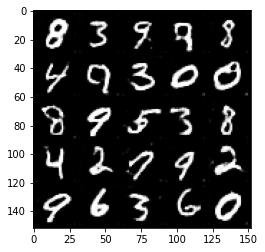

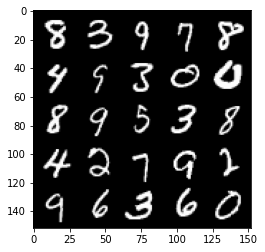

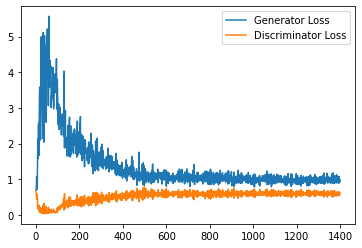

 76%|███████▌  | 357/469 [00:10<00:03, 33.98it/s]

Step 28500: Generator loss: 0.9731236690282822, discriminator loss: 0.5940695499181747


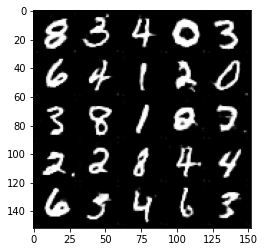

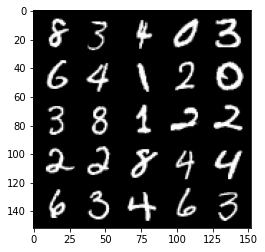

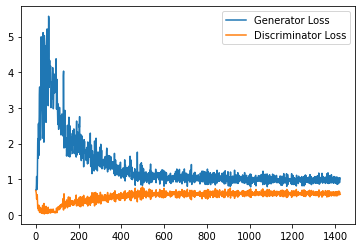

 83%|████████▎ | 390/469 [00:12<00:02, 33.39it/s]

Step 29000: Generator loss: 0.9678018548488617, discriminator loss: 0.5917435339093209


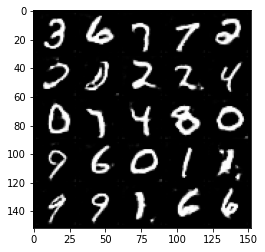

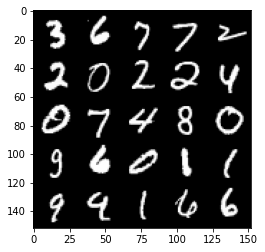

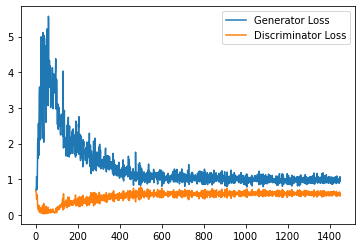

 90%|████████▉ | 420/469 [00:12<00:01, 33.61it/s]

Step 29500: Generator loss: 0.9839466001987457, discriminator loss: 0.5920726829171181


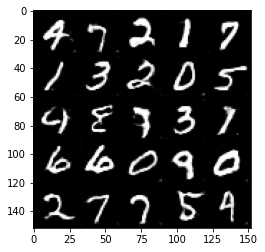

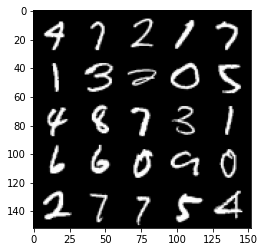

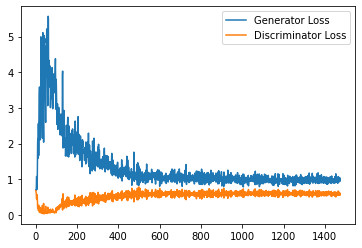

 97%|█████████▋| 453/469 [00:13<00:00, 36.09it/s]

Step 30000: Generator loss: 0.9766835105419159, discriminator loss: 0.5931507202386856


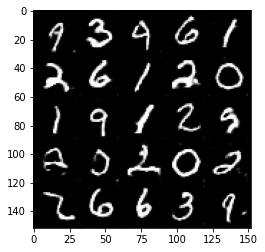

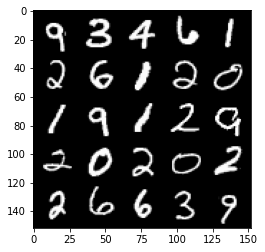

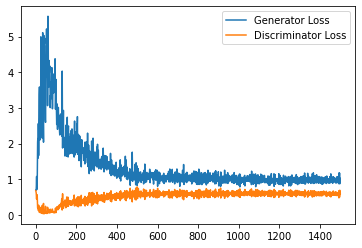

  3%|▎         | 12/469 [00:00<00:13, 33.18it/s]

Step 30500: Generator loss: 0.9748390974998474, discriminator loss: 0.5953137367963791


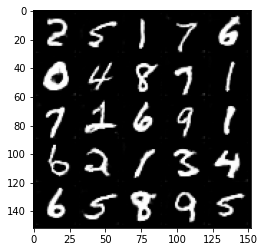

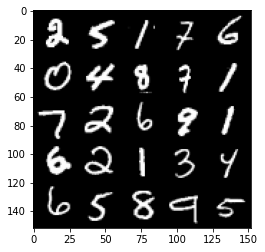

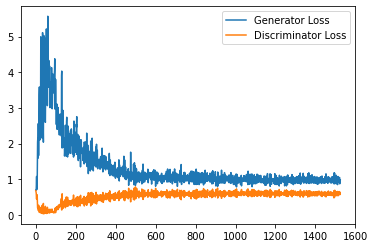

  9%|▉         | 44/469 [00:01<00:13, 30.62it/s]

Step 31000: Generator loss: 1.0139171571731567, discriminator loss: 0.5945345555543899


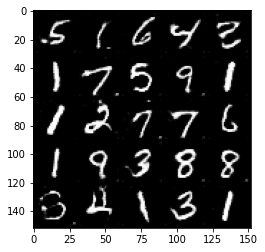

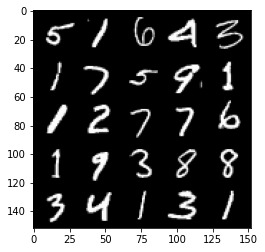

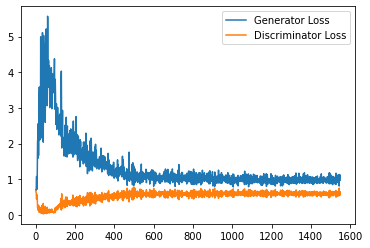

 16%|█▌        | 73/469 [00:02<00:10, 36.11it/s]

Step 31500: Generator loss: 0.9739926007986068, discriminator loss: 0.5976630175709724


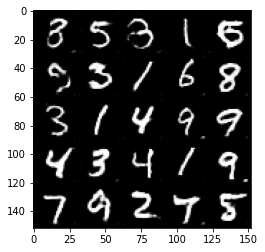

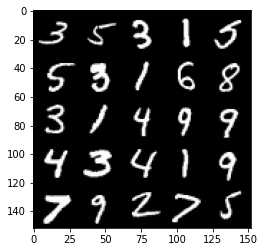

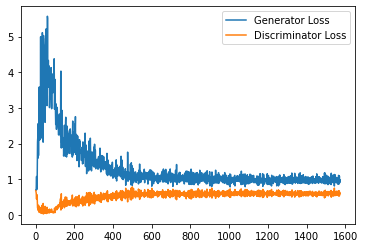

 22%|██▏       | 105/469 [00:03<00:10, 35.87it/s]

Step 32000: Generator loss: 0.97025814473629, discriminator loss: 0.5924916025996209


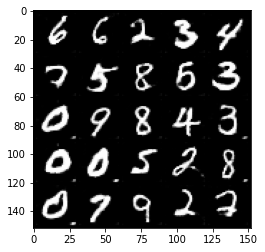

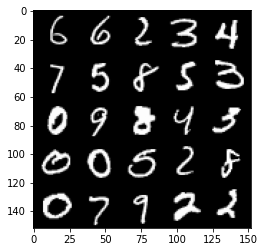

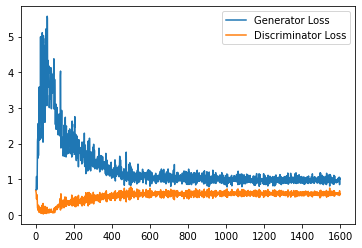

 29%|██▉       | 136/469 [00:04<00:09, 33.89it/s]

Step 32500: Generator loss: 0.9768768463134766, discriminator loss: 0.595141151189804


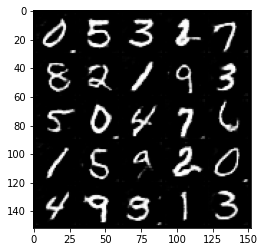

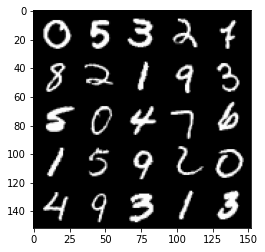

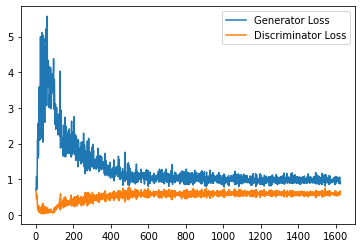

 36%|███▌      | 170/469 [00:05<00:08, 33.55it/s]

Step 33000: Generator loss: 0.9836509171724319, discriminator loss: 0.5958762999773025


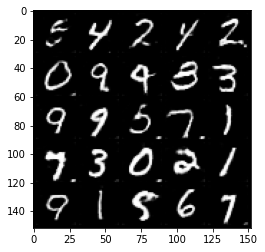

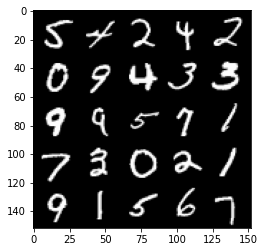

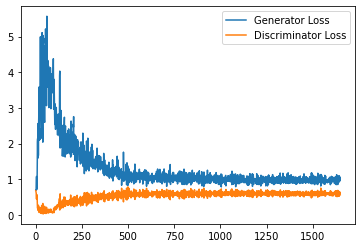

 43%|████▎     | 200/469 [00:06<00:08, 31.41it/s]

Step 33500: Generator loss: 0.9916435871124267, discriminator loss: 0.5922167854905128


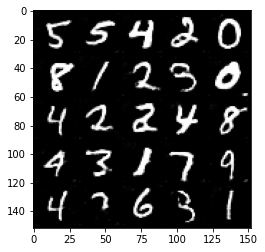

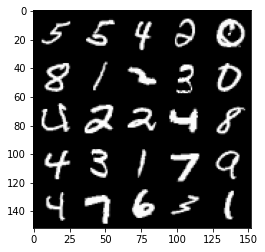

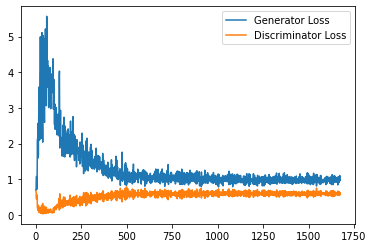

 49%|████▉     | 229/469 [00:06<00:06, 35.02it/s]

Step 34000: Generator loss: 0.9875638313293457, discriminator loss: 0.5948800913095474


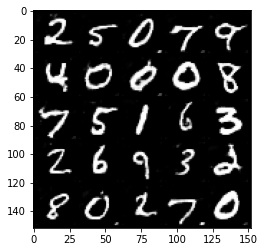

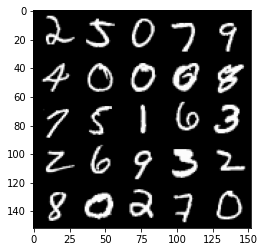

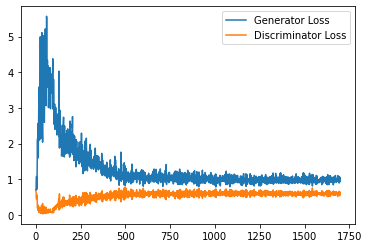

 56%|█████▌    | 261/469 [00:08<00:06, 30.00it/s]

Step 34500: Generator loss: 0.9949365501403808, discriminator loss: 0.5900806710720062


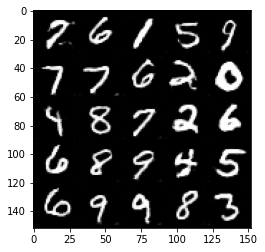

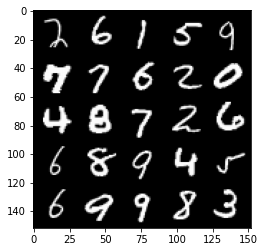

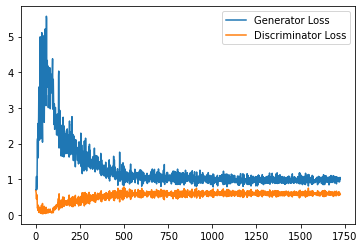

 62%|██████▏   | 293/469 [00:08<00:05, 34.41it/s]

Step 35000: Generator loss: 0.9673109916448593, discriminator loss: 0.5956730917692185


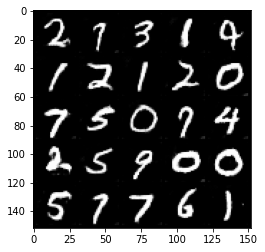

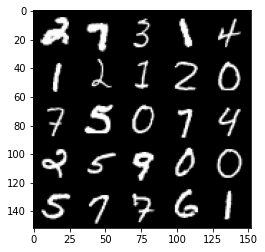

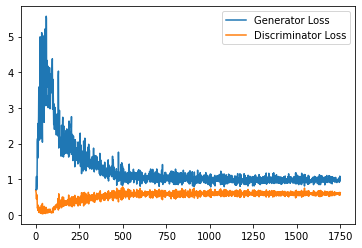

 69%|██████▉   | 323/469 [00:09<00:04, 31.84it/s]

Step 35500: Generator loss: 1.0044076828956603, discriminator loss: 0.5900534327030182


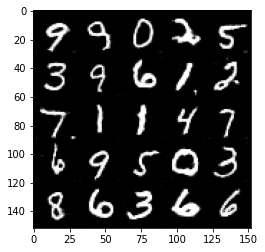

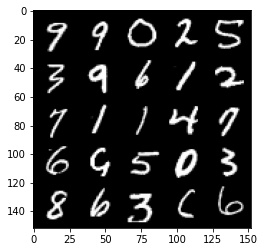

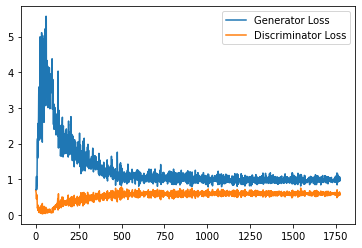

 76%|███████▌  | 355/469 [00:10<00:03, 32.88it/s]

Step 36000: Generator loss: 0.9979296717643737, discriminator loss: 0.5953997902274132


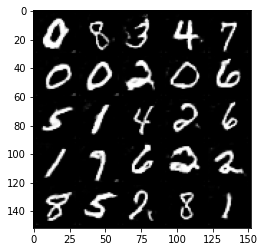

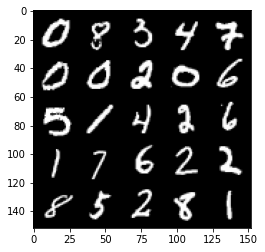

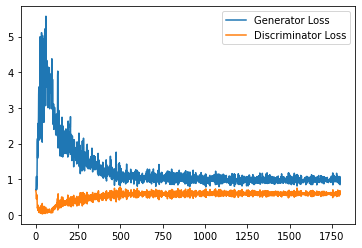

 82%|████████▏ | 386/469 [00:11<00:02, 33.81it/s]

Step 36500: Generator loss: 0.9758059812784194, discriminator loss: 0.5918192621469498


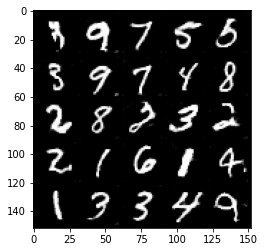

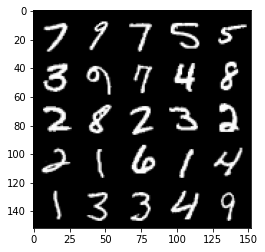

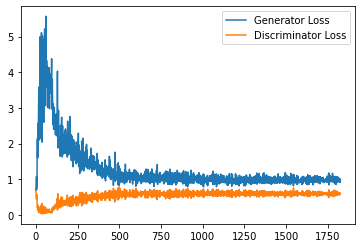

 89%|████████▉ | 418/469 [00:13<00:01, 34.99it/s]

Step 37000: Generator loss: 0.9974948781728744, discriminator loss: 0.5948821303844452


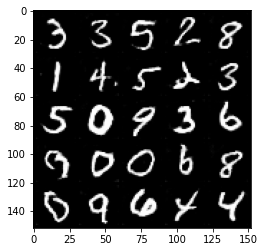

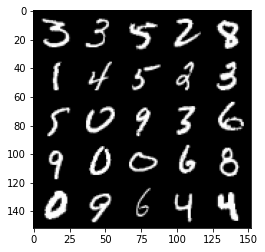

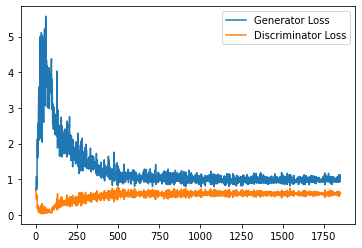

 95%|█████████▌| 447/469 [00:13<00:00, 33.52it/s]

Step 37500: Generator loss: 0.9831090257167816, discriminator loss: 0.5968215699195862


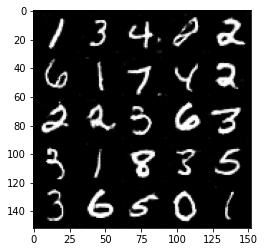

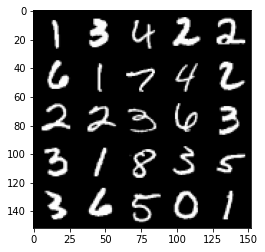

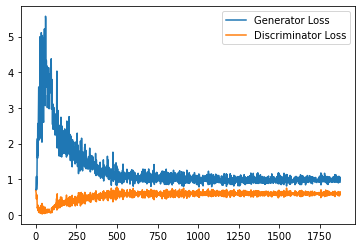

  2%|▏         | 8/469 [00:00<00:13, 34.35it/s]

Step 38000: Generator loss: 1.0031283806562423, discriminator loss: 0.5917980636954308


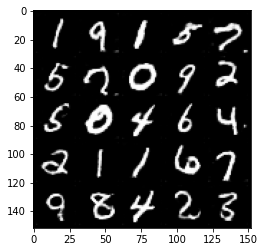

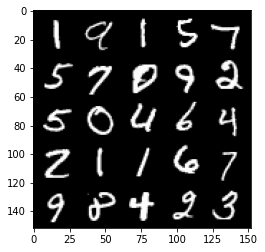

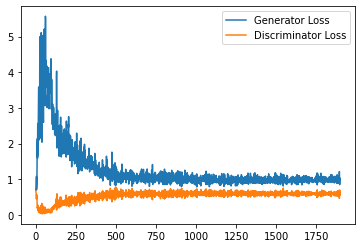

  9%|▊         | 40/469 [00:01<00:12, 33.77it/s]

Step 38500: Generator loss: 1.0012869367599486, discriminator loss: 0.5948943277001381


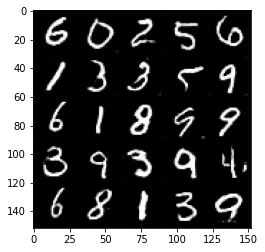

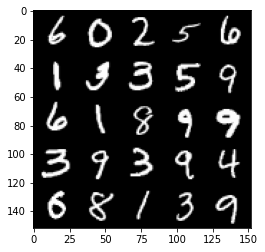

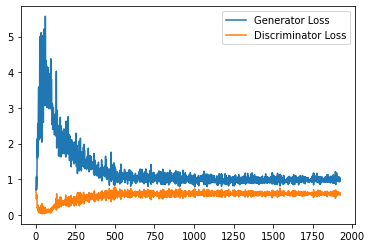

 15%|█▍        | 70/469 [00:02<00:11, 34.67it/s]

Step 39000: Generator loss: 0.9845758873224258, discriminator loss: 0.5986021509170533


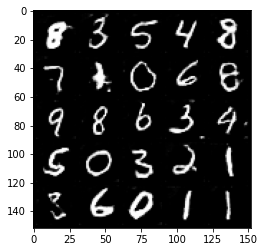

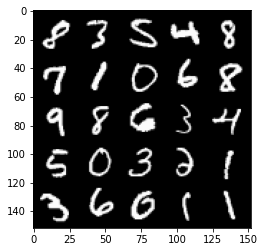

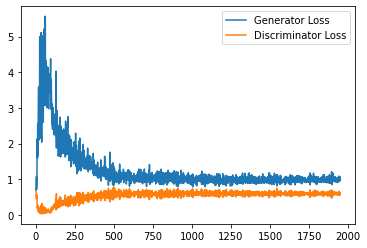

 22%|██▏       | 102/469 [00:03<00:11, 33.21it/s]

Step 39500: Generator loss: 0.9737217333316803, discriminator loss: 0.5959382247328758


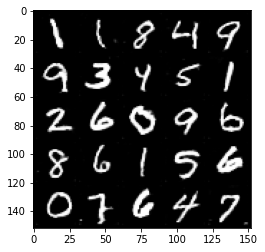

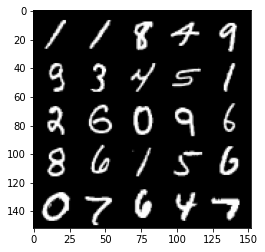

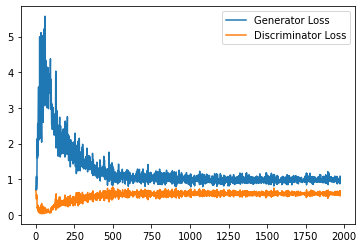

 29%|██▊       | 134/469 [00:03<00:09, 33.59it/s]

Step 40000: Generator loss: 0.9828911254405975, discriminator loss: 0.5972003841400146


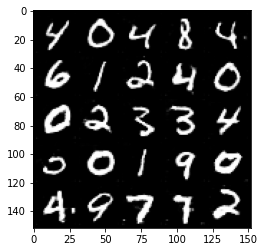

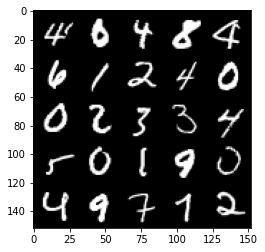

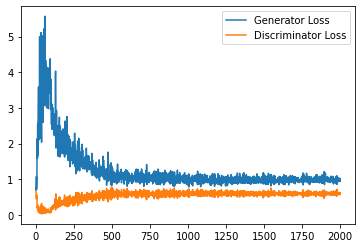

 35%|███▌      | 165/469 [00:04<00:08, 35.46it/s]

Step 40500: Generator loss: 0.9691066057682037, discriminator loss: 0.5935485200881958


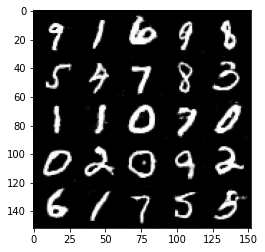

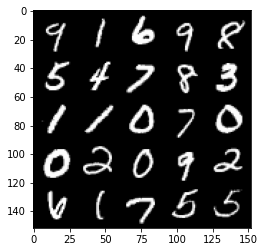

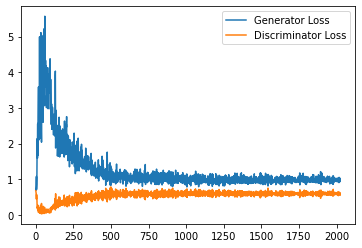

 42%|████▏     | 197/469 [00:06<00:08, 33.65it/s]

Step 41000: Generator loss: 0.9746718661785125, discriminator loss: 0.5962674547433853


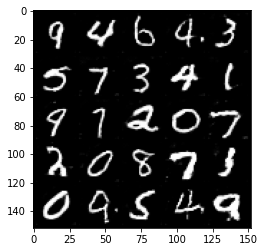

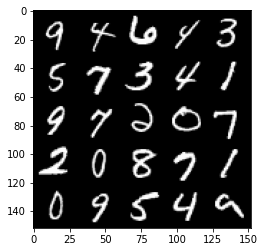

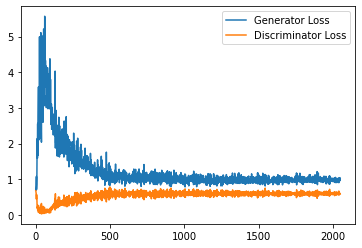

 49%|████▊     | 228/469 [00:06<00:07, 31.36it/s]

Step 41500: Generator loss: 0.981571814417839, discriminator loss: 0.601296038210392


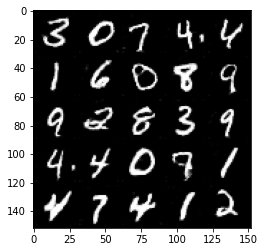

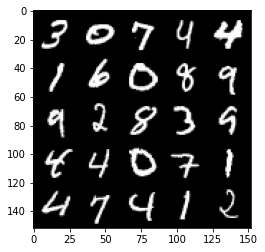

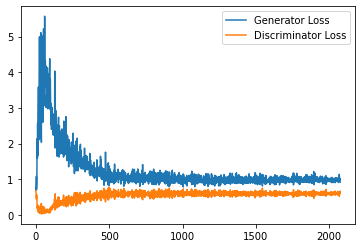

 55%|█████▍    | 257/469 [00:07<00:06, 31.05it/s]

Step 42000: Generator loss: 1.0058669950962067, discriminator loss: 0.5931130464673042


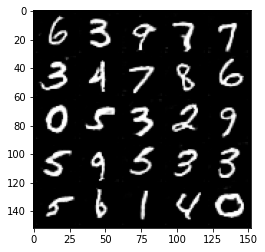

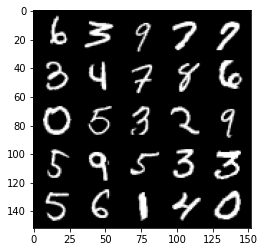

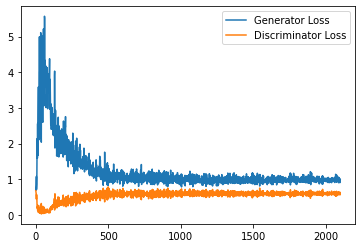

 62%|██████▏   | 289/469 [00:08<00:05, 33.22it/s]

Step 42500: Generator loss: 0.9843784286975861, discriminator loss: 0.5993630112409591


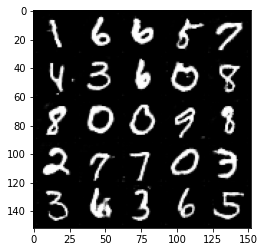

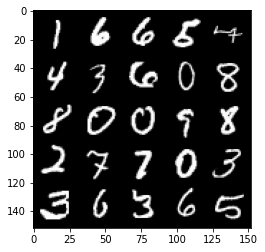

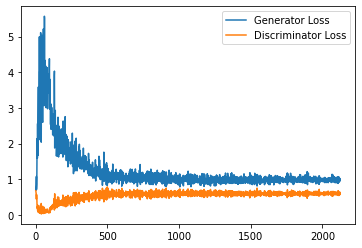

 68%|██████▊   | 318/469 [00:09<00:04, 33.40it/s]

Step 43000: Generator loss: 0.9715225055217743, discriminator loss: 0.5994482300281525


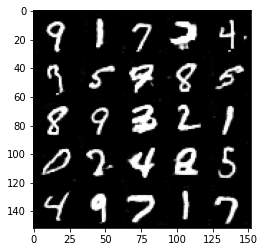

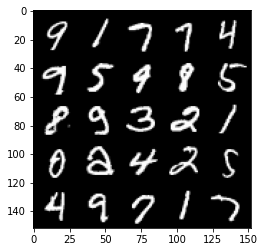

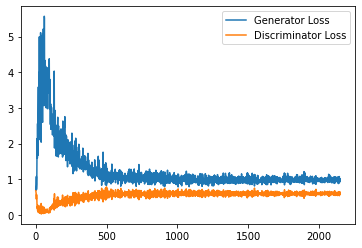

 75%|███████▍  | 350/469 [00:10<00:03, 33.62it/s]

Step 43500: Generator loss: 0.973787534236908, discriminator loss: 0.5976289385557174


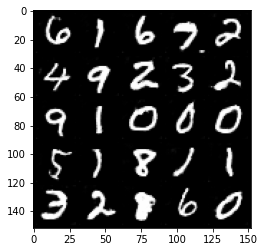

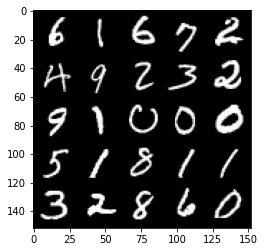

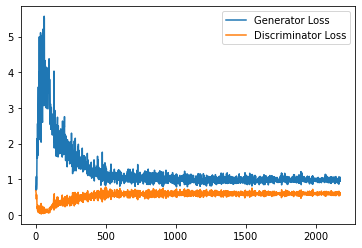

 81%|████████  | 380/469 [00:11<00:02, 33.84it/s]

Step 44000: Generator loss: 0.9807052400112152, discriminator loss: 0.5986169816851616


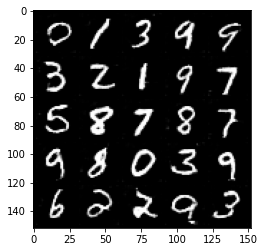

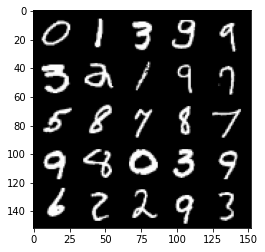

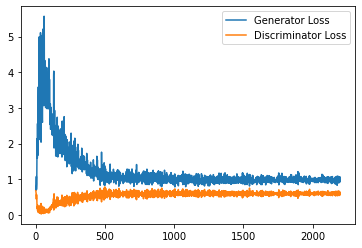

 88%|████████▊ | 412/469 [00:12<00:01, 33.06it/s]

Step 44500: Generator loss: 0.9869965648651123, discriminator loss: 0.604680661201477


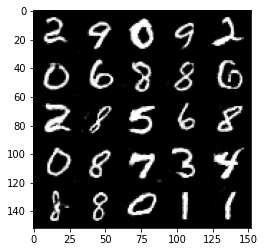

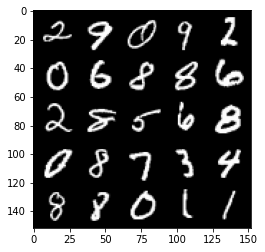

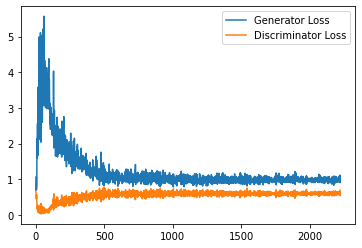

 94%|█████████▍| 441/469 [00:14<00:00, 29.24it/s]

Step 45000: Generator loss: 0.9805137739181519, discriminator loss: 0.5994567097425461


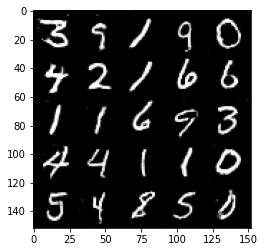

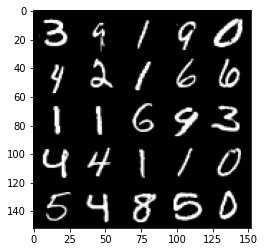

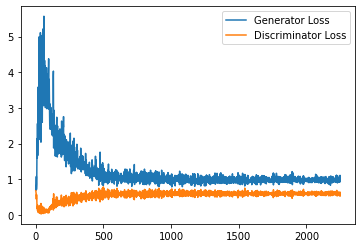

  1%|          | 4/469 [00:00<00:12, 37.89it/s]

Step 45500: Generator loss: 0.9903792828321457, discriminator loss: 0.5953426006436348


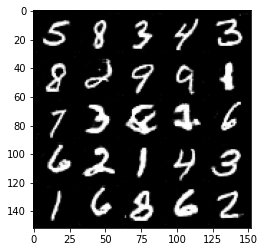

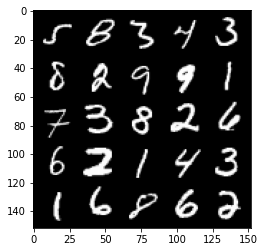

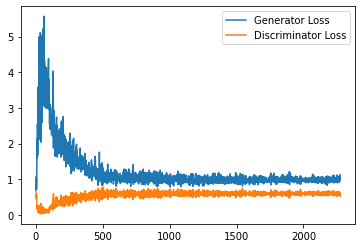

  7%|▋         | 35/469 [00:01<00:13, 32.33it/s]

Step 46000: Generator loss: 0.9882613322734832, discriminator loss: 0.602634259223938


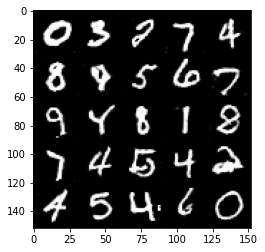

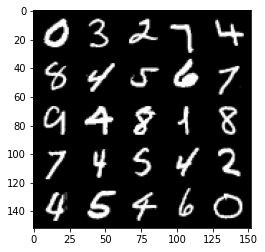

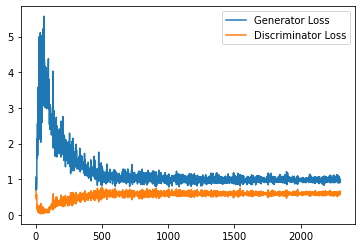

 14%|█▍        | 68/469 [00:02<00:13, 30.64it/s]

Step 46500: Generator loss: 0.9668876556158066, discriminator loss: 0.5987574590444564


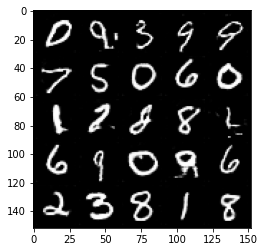

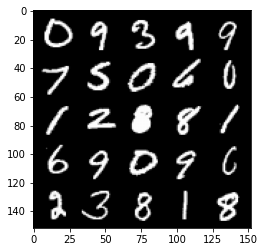

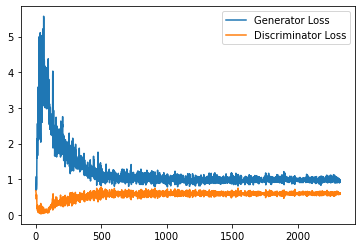

 21%|██        | 97/469 [00:02<00:11, 33.02it/s]

Step 47000: Generator loss: 0.9750956362485885, discriminator loss: 0.5949115726947785


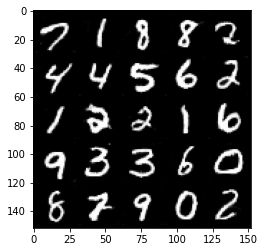

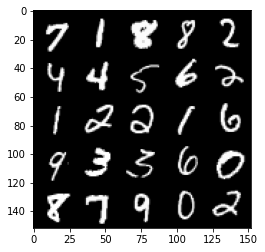

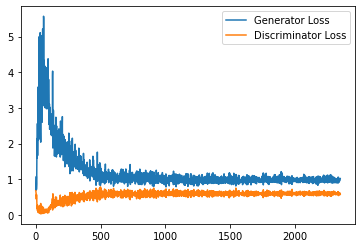

 28%|██▊       | 129/469 [00:03<00:09, 34.86it/s]

Step 47500: Generator loss: 1.0019865000247956, discriminator loss: 0.5976947920322419


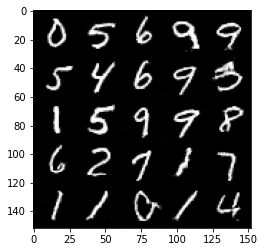

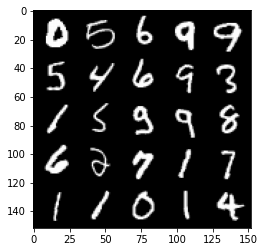

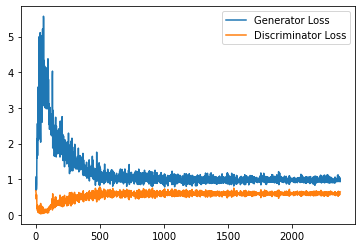

 34%|███▍      | 161/469 [00:04<00:09, 33.17it/s]

Step 48000: Generator loss: 1.006089250087738, discriminator loss: 0.5971395711302757


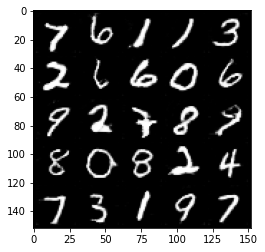

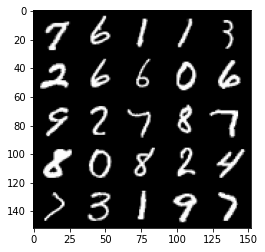

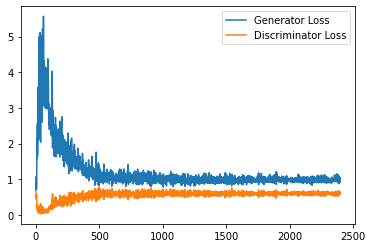

 41%|████      | 193/469 [00:05<00:08, 32.63it/s]

Step 48500: Generator loss: 1.002414716720581, discriminator loss: 0.5965191439986229


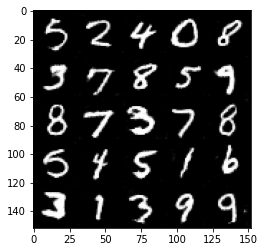

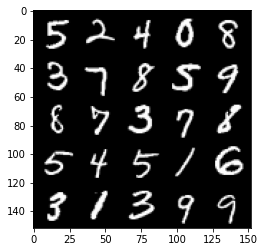

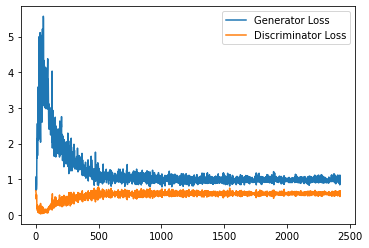

 47%|████▋     | 222/469 [00:07<00:07, 33.20it/s]

Step 49000: Generator loss: 1.0040466516017914, discriminator loss: 0.59555097001791


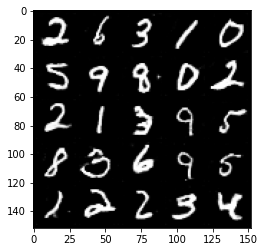

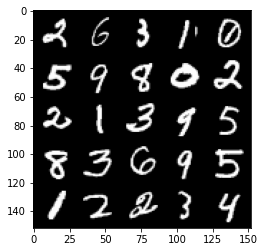

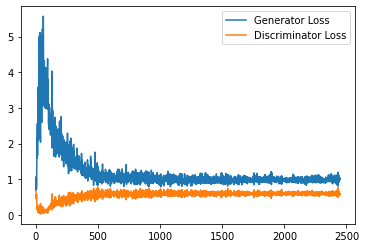

 54%|█████▍    | 253/469 [00:07<00:06, 32.41it/s]

Step 49500: Generator loss: 0.9852757163047791, discriminator loss: 0.5928429773449898


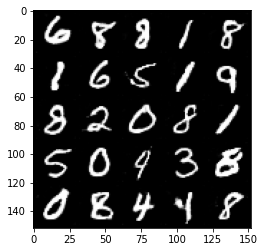

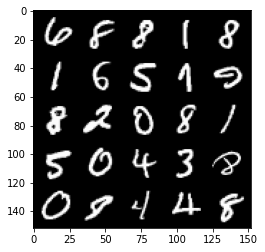

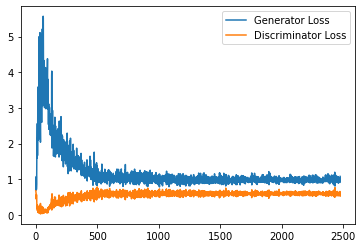

 61%|██████    | 285/469 [00:08<00:05, 33.52it/s]

Step 50000: Generator loss: 0.9795318551063538, discriminator loss: 0.5969363954663277


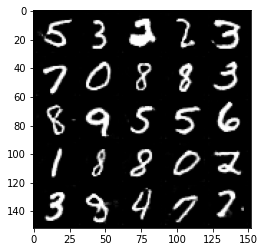

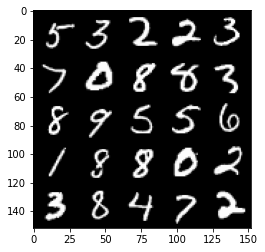

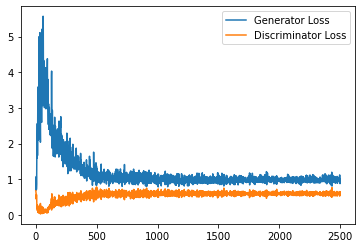

 67%|██████▋   | 314/469 [00:09<00:04, 34.62it/s]

Step 50500: Generator loss: 1.0056456508636475, discriminator loss: 0.5932160017490387


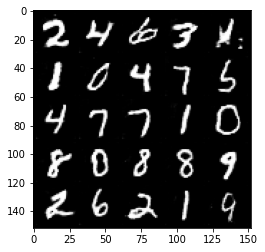

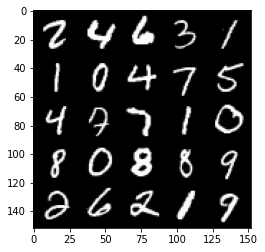

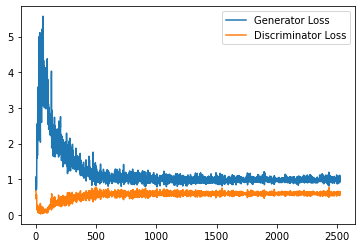

 74%|███████▍  | 346/469 [00:09<00:03, 36.87it/s]

Step 51000: Generator loss: 0.9840579270124435, discriminator loss: 0.5962763592600823


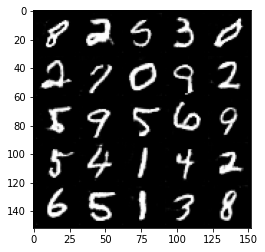

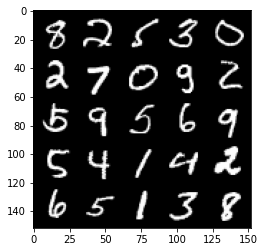

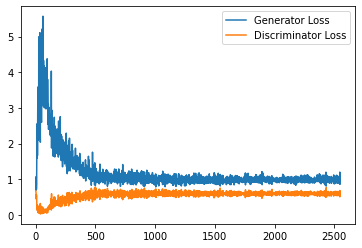

 80%|████████  | 377/469 [00:11<00:02, 33.69it/s]

Step 51500: Generator loss: 1.014805186033249, discriminator loss: 0.5946897590756416


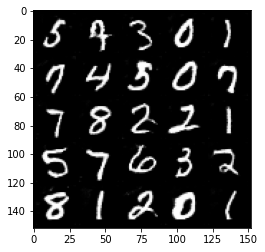

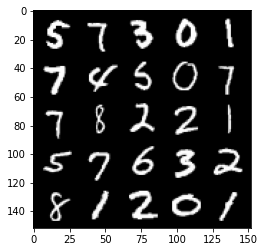

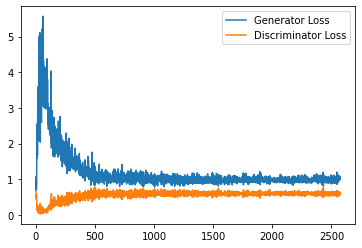

 87%|████████▋ | 410/469 [00:12<00:01, 33.60it/s]

Step 52000: Generator loss: 1.0103412029743195, discriminator loss: 0.5933959928154945


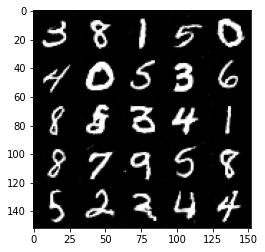

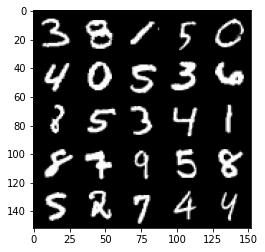

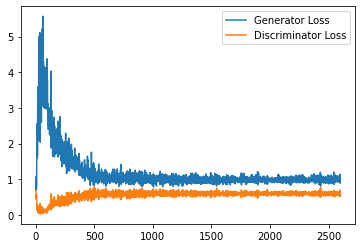

 94%|█████████▎| 439/469 [00:13<00:00, 31.48it/s]

Step 52500: Generator loss: 1.0004793537855148, discriminator loss: 0.5980286479592324


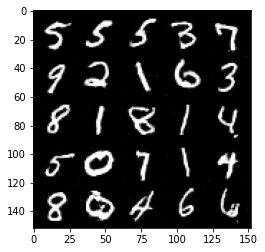

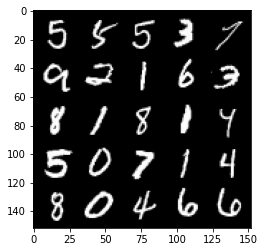

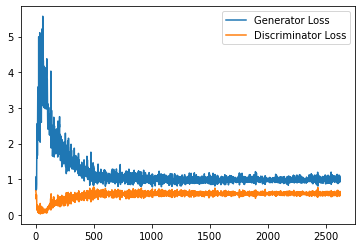

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53000: Generator loss: 0.992212774515152, discriminator loss: 0.5950002581477165


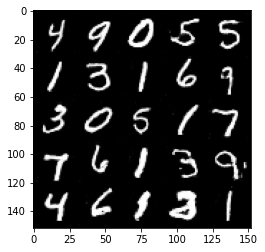

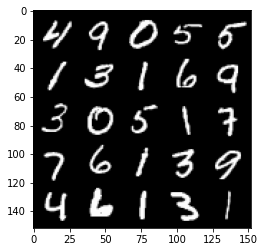

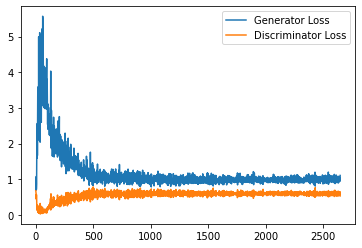

  7%|▋         | 32/469 [00:00<00:13, 32.54it/s]

Step 53500: Generator loss: 0.993374140739441, discriminator loss: 0.5944744173884392


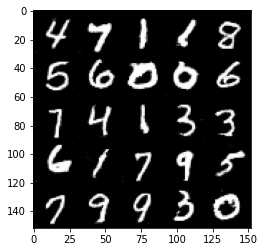

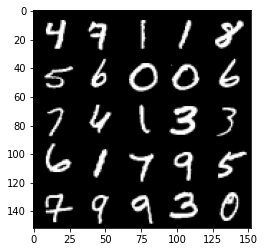

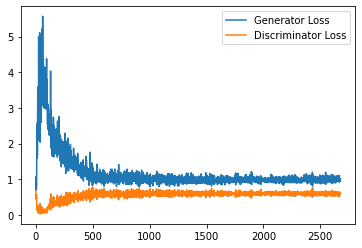

 14%|█▎        | 64/469 [00:01<00:12, 33.55it/s]

Step 54000: Generator loss: 0.9985846402645111, discriminator loss: 0.5892757222056388


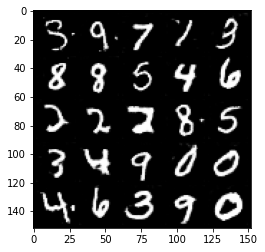

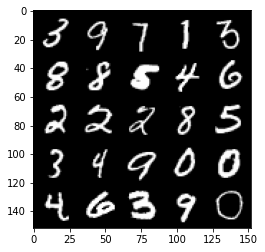

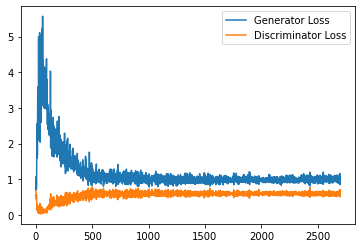

 20%|██        | 96/469 [00:02<00:11, 32.81it/s]

Step 54500: Generator loss: 0.9860275167226792, discriminator loss: 0.5952819544076919


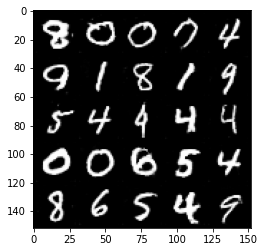

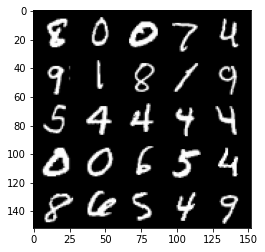

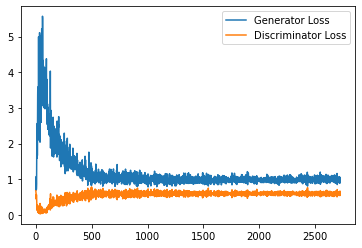

 26%|██▋       | 124/469 [00:03<00:10, 33.71it/s]

Step 55000: Generator loss: 0.9977313361167908, discriminator loss: 0.5935588700771331


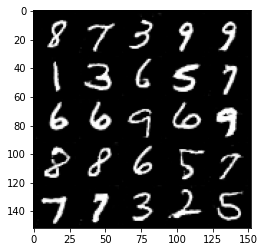

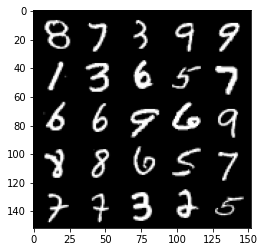

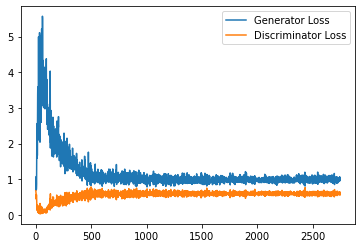

 33%|███▎      | 156/469 [00:04<00:09, 33.91it/s]

Step 55500: Generator loss: 1.0154602677822113, discriminator loss: 0.5939435178637504


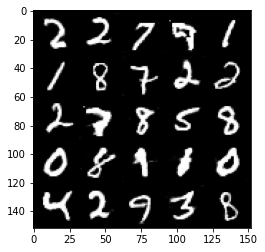

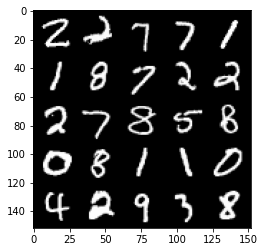

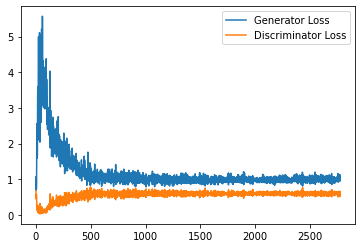

 40%|████      | 188/469 [00:05<00:08, 34.35it/s]

Step 56000: Generator loss: 0.9887886683940887, discriminator loss: 0.5960074080228805


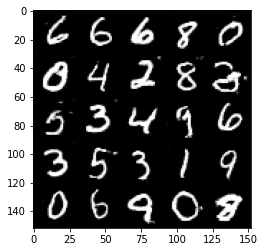

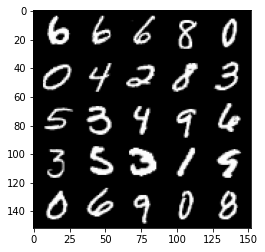

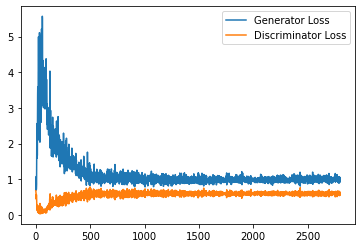

 46%|████▋     | 218/469 [00:06<00:07, 33.39it/s]

Step 56500: Generator loss: 0.9948933485746384, discriminator loss: 0.5932334660291672


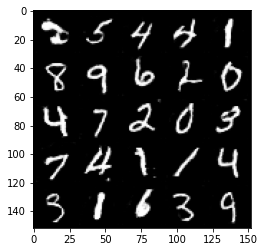

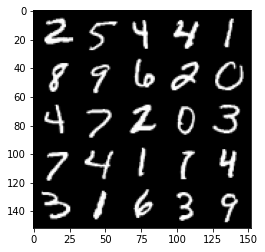

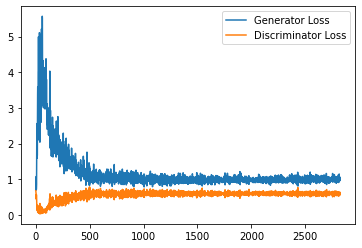

 53%|█████▎    | 249/469 [00:07<00:06, 32.56it/s]

Step 57000: Generator loss: 0.9943679398298264, discriminator loss: 0.5911705661416053


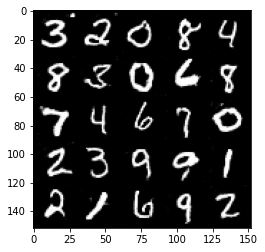

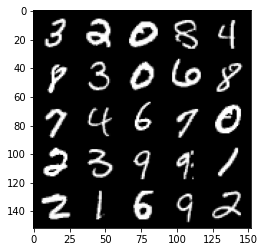

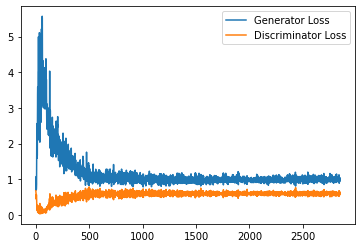

 59%|█████▉    | 279/469 [00:08<00:05, 35.27it/s]

Step 57500: Generator loss: 1.0118566310405732, discriminator loss: 0.5879238242506981


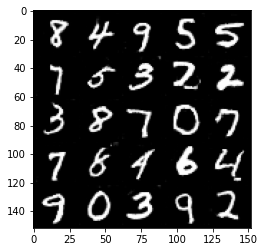

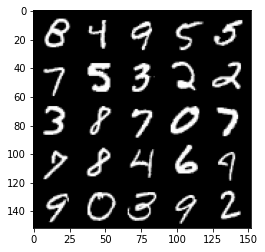

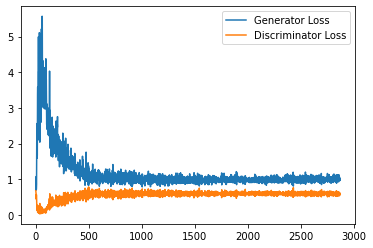

 67%|██████▋   | 313/469 [00:09<00:04, 33.07it/s]

Step 58000: Generator loss: 0.9839692687988282, discriminator loss: 0.5945123370289802


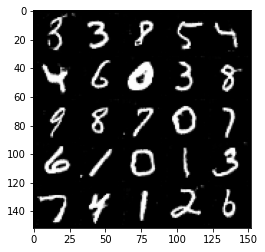

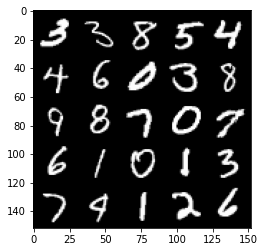

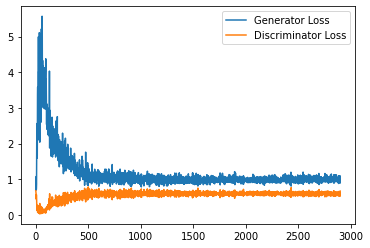

 73%|███████▎  | 342/469 [00:10<00:03, 33.19it/s]

Step 58500: Generator loss: 1.015624936580658, discriminator loss: 0.588668330669403


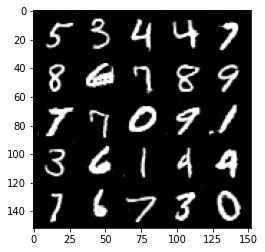

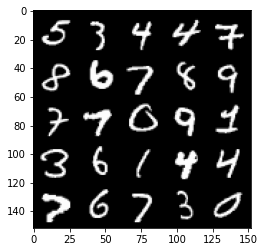

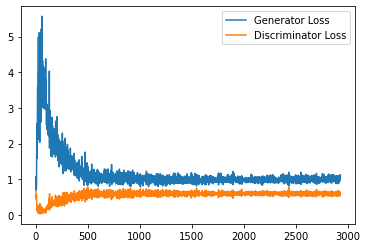

 80%|███████▉  | 373/469 [00:10<00:02, 33.97it/s]

Step 59000: Generator loss: 1.0106239085197448, discriminator loss: 0.5906583524346352


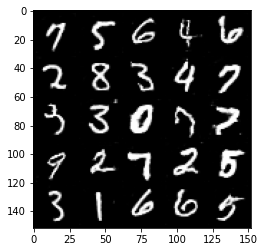

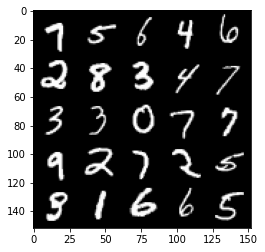

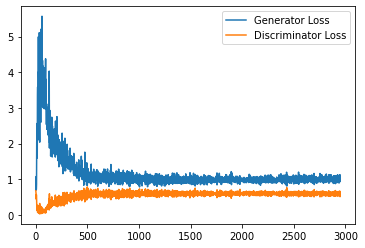

 87%|████████▋ | 406/469 [00:11<00:01, 35.80it/s]

Step 59500: Generator loss: 0.9999488443136215, discriminator loss: 0.5951868137717247


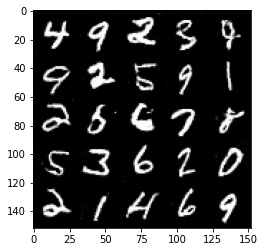

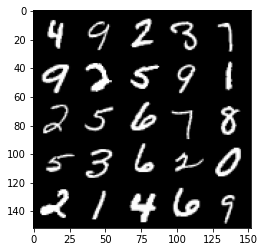

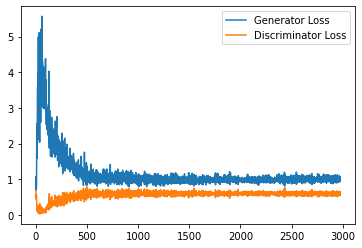

 93%|█████████▎| 435/469 [00:12<00:01, 31.01it/s]

Step 60000: Generator loss: 1.0107509663105012, discriminator loss: 0.5956697837710381


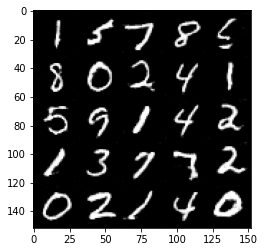

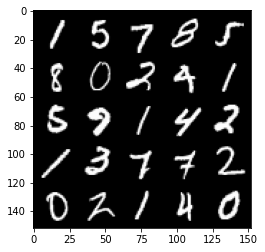

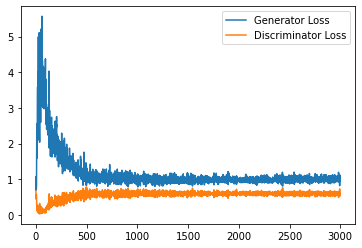

100%|█████████▉| 467/469 [00:13<00:00, 33.82it/s]

Step 60500: Generator loss: 1.0045849620103835, discriminator loss: 0.5964858766198158


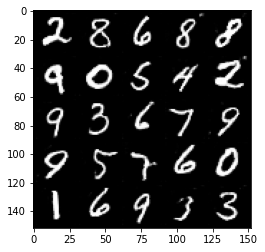

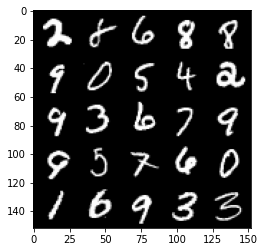

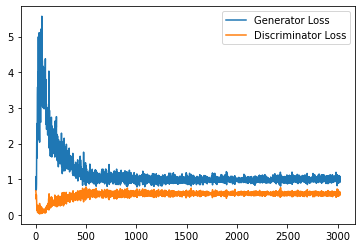

  6%|▌         | 28/469 [00:00<00:13, 33.92it/s]

Step 61000: Generator loss: 1.0323355395793914, discriminator loss: 0.5893877821564675


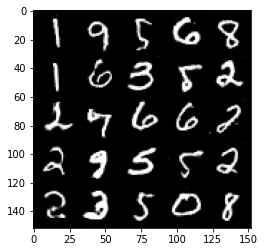

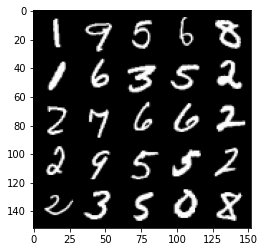

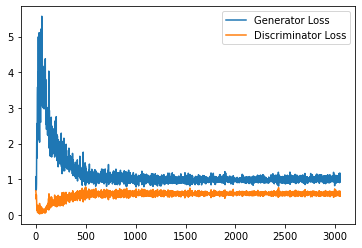

 13%|█▎        | 60/469 [00:01<00:11, 35.15it/s]

Step 61500: Generator loss: 1.0172147628068924, discriminator loss: 0.5913392034769058


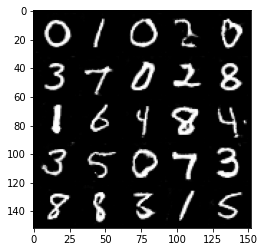

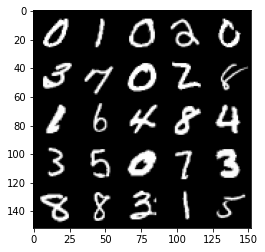

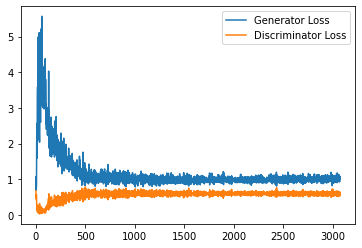

 19%|█▉        | 89/469 [00:02<00:11, 33.71it/s]

Step 62000: Generator loss: 0.9987912906408309, discriminator loss: 0.589506894826889


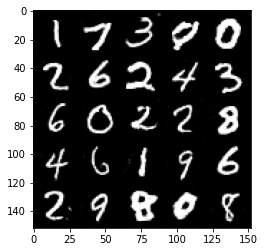

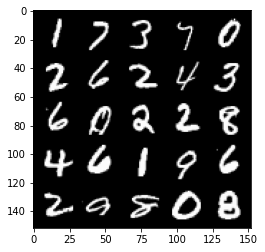

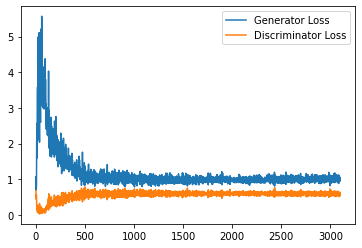

 26%|██▌       | 121/469 [00:03<00:10, 32.47it/s]

Step 62500: Generator loss: 1.0117984417676926, discriminator loss: 0.5907169423699379


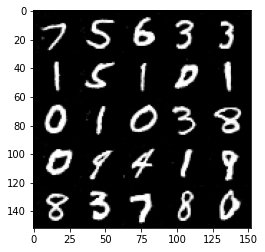

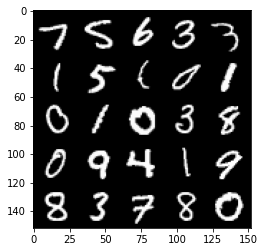

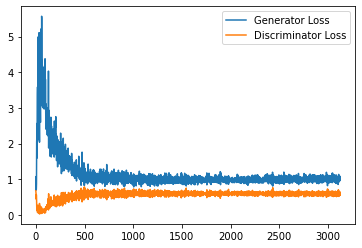

 32%|███▏      | 152/469 [00:04<00:09, 33.79it/s]

Step 63000: Generator loss: 1.0229876055717468, discriminator loss: 0.5849628472328186


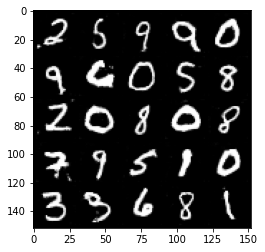

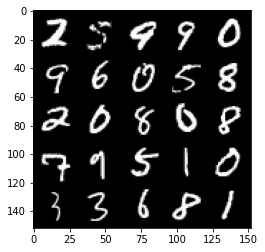

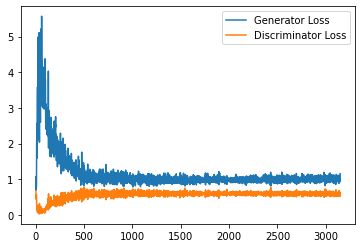

 39%|███▉      | 184/469 [00:05<00:08, 34.52it/s]

Step 63500: Generator loss: 1.0049979267120361, discriminator loss: 0.5892046775817871


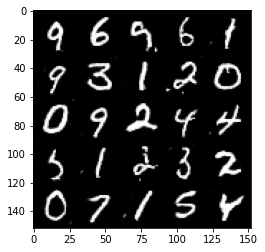

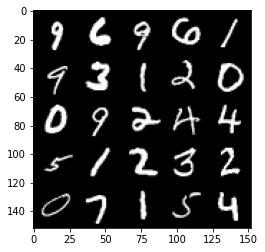

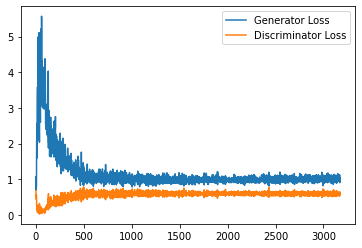

 46%|████▌     | 216/469 [00:06<00:08, 30.95it/s]

Step 64000: Generator loss: 1.017617940068245, discriminator loss: 0.5878313935995102


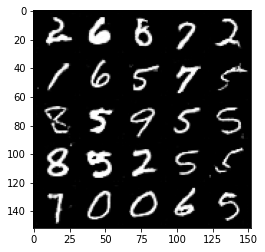

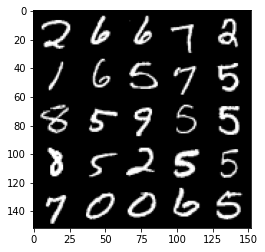

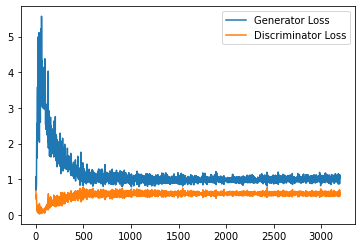

 52%|█████▏    | 245/469 [00:07<00:06, 33.65it/s]

Step 64500: Generator loss: 1.001204385638237, discriminator loss: 0.5941753892898559


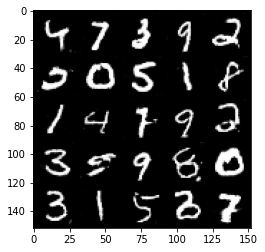

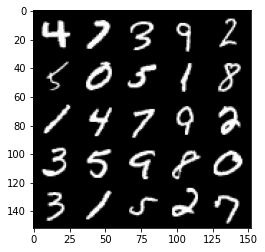

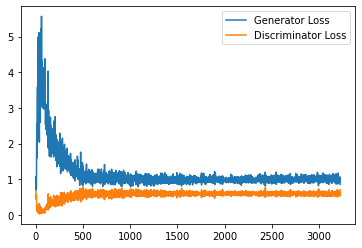

 59%|█████▉    | 278/469 [00:08<00:05, 34.00it/s]

Step 65000: Generator loss: 1.0235993897914886, discriminator loss: 0.5828247373700142


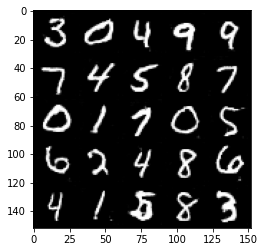

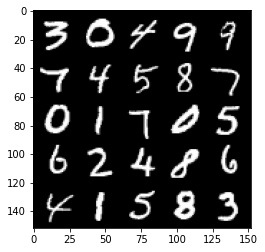

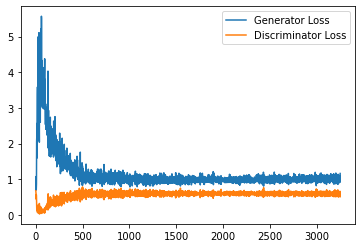

 65%|██████▌   | 307/469 [00:09<00:05, 30.83it/s]

Step 65500: Generator loss: 1.0052023476362228, discriminator loss: 0.5914034370183945


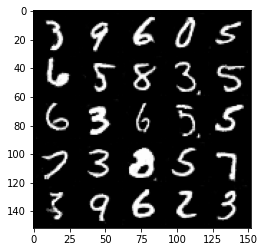

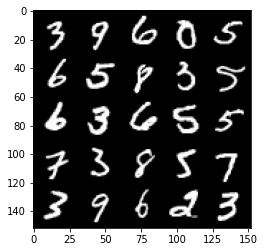

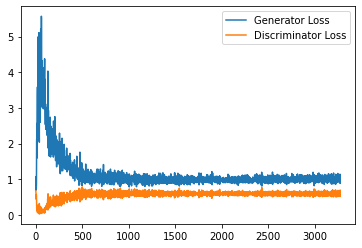

 72%|███████▏  | 339/469 [00:10<00:04, 31.71it/s]

Step 66000: Generator loss: 1.0256523014307022, discriminator loss: 0.5915964124202728


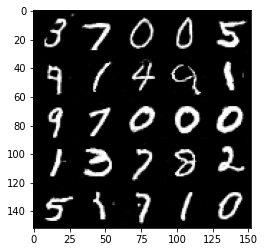

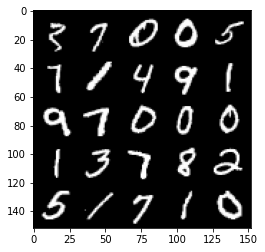

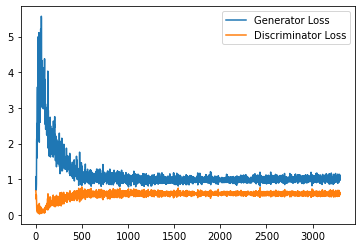

 78%|███████▊  | 368/469 [00:11<00:02, 36.78it/s]

Step 66500: Generator loss: 1.0349360642433167, discriminator loss: 0.5827944364547729


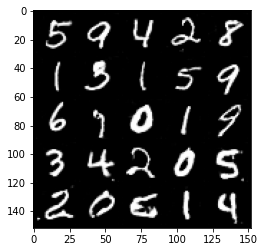

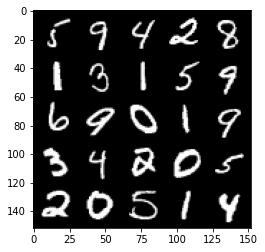

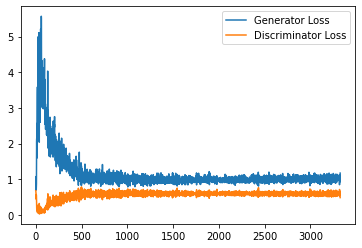

 86%|████████▌ | 402/469 [00:11<00:01, 34.29it/s]

Step 67000: Generator loss: 1.010552657365799, discriminator loss: 0.5910731994509697


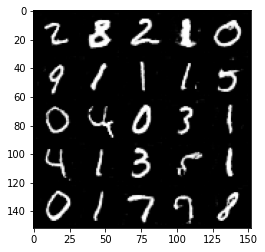

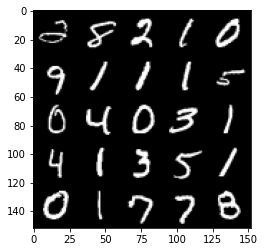

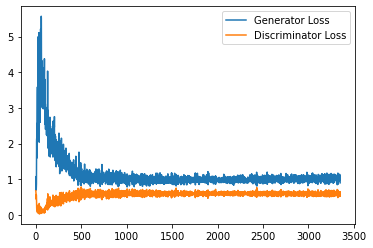

 92%|█████████▏| 433/469 [00:12<00:01, 34.10it/s]

Step 67500: Generator loss: 1.006334497332573, discriminator loss: 0.5889263359904289


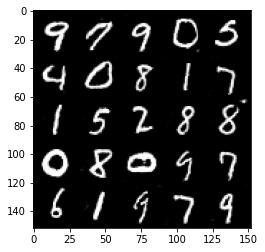

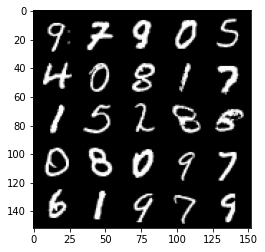

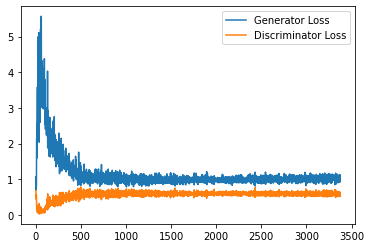

 99%|█████████▊| 462/469 [00:13<00:00, 34.44it/s]

Step 68000: Generator loss: 1.0283509060144425, discriminator loss: 0.5879924949407578


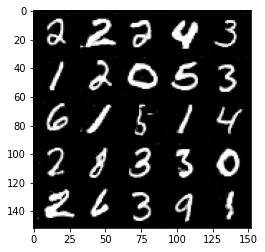

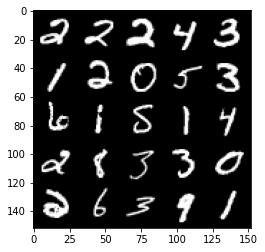

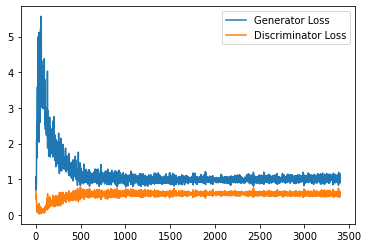

  5%|▌         | 24/469 [00:00<00:13, 33.01it/s]

Step 68500: Generator loss: 1.0139942770004273, discriminator loss: 0.5862431136965751


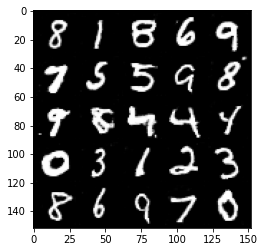

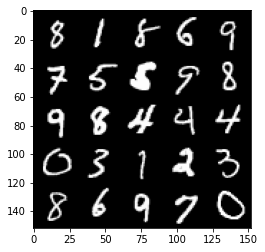

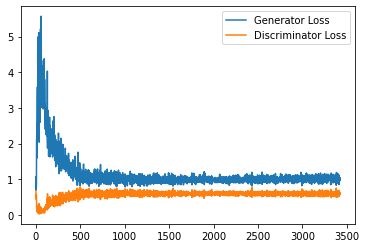

 12%|█▏        | 57/469 [00:01<00:11, 35.42it/s]

Step 69000: Generator loss: 1.0078083559274673, discriminator loss: 0.5853830143213272


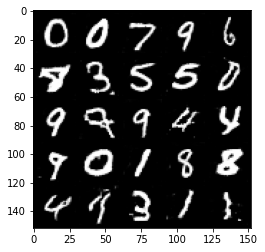

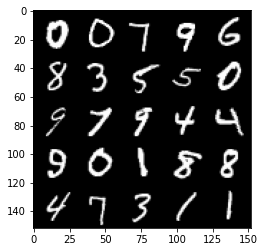

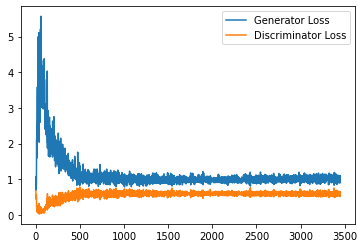

 19%|█▉        | 88/469 [00:02<00:11, 33.60it/s]

Step 69500: Generator loss: 1.0255272889137268, discriminator loss: 0.5852316426038742


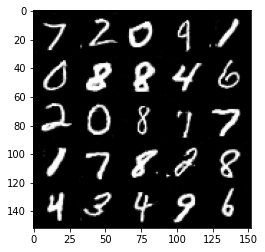

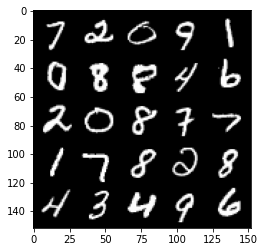

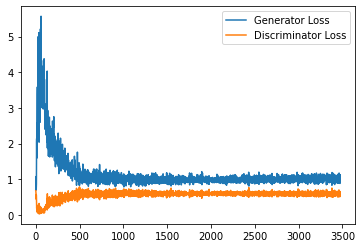

 25%|██▍       | 116/469 [00:03<00:10, 34.66it/s]

Step 70000: Generator loss: 1.0176585743427276, discriminator loss: 0.5875043137073517


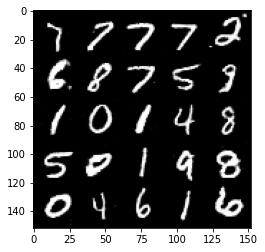

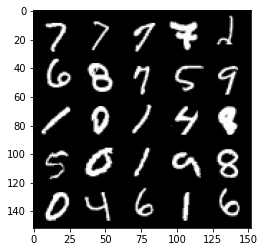

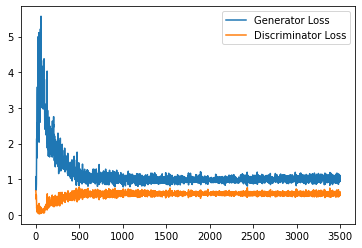

 32%|███▏      | 148/469 [00:04<00:10, 31.47it/s]

Step 70500: Generator loss: 1.0255395542383194, discriminator loss: 0.5844918059706687


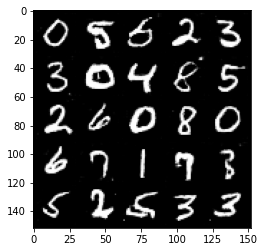

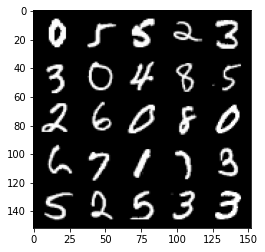

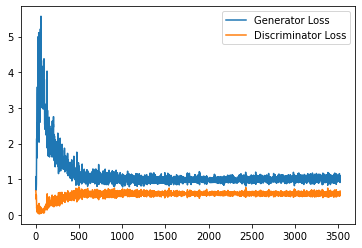

 38%|███▊      | 178/469 [00:05<00:08, 33.71it/s]

Step 71000: Generator loss: 1.028015224456787, discriminator loss: 0.5825050716400146


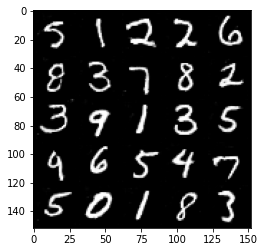

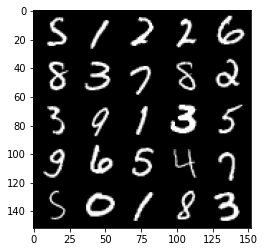

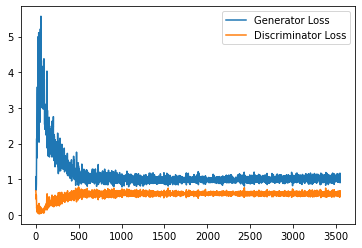

 45%|████▍     | 211/469 [00:06<00:07, 32.67it/s]

Step 71500: Generator loss: 1.0234957110881806, discriminator loss: 0.5835444459915161


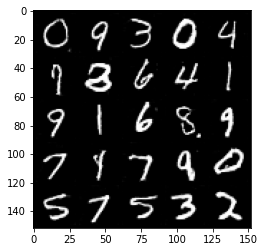

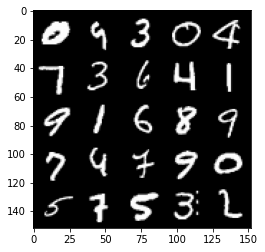

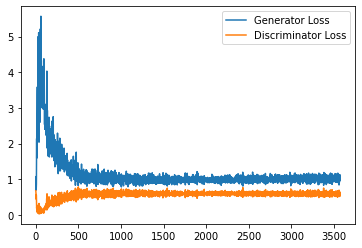

 51%|█████     | 240/469 [00:07<00:06, 34.48it/s]

Step 72000: Generator loss: 1.0411318769454956, discriminator loss: 0.585502976179123


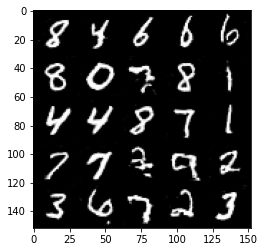

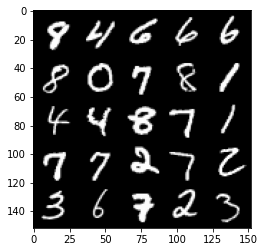

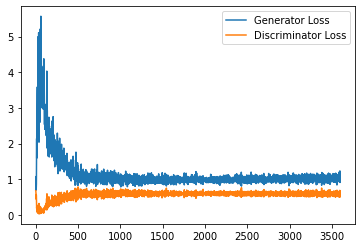

 58%|█████▊    | 272/469 [00:08<00:05, 33.13it/s]

Step 72500: Generator loss: 1.0153256632089616, discriminator loss: 0.5841767187714577


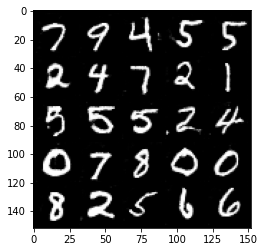

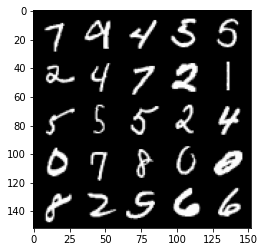

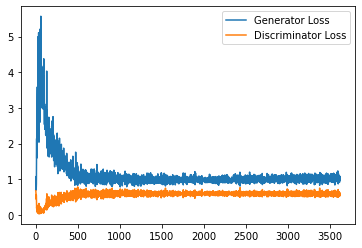

 64%|██████▍   | 302/469 [00:09<00:05, 32.73it/s]

Step 73000: Generator loss: 1.042313907623291, discriminator loss: 0.5850828073620796


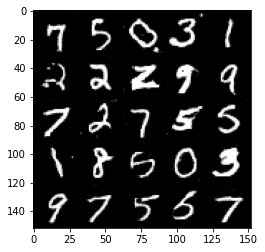

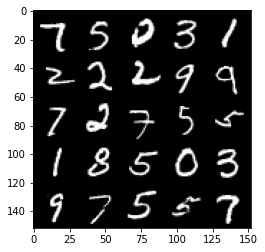

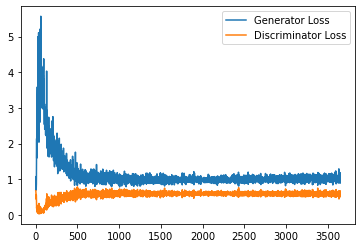

 71%|███████   | 333/469 [00:09<00:04, 33.69it/s]

Step 73500: Generator loss: 1.0315517327785493, discriminator loss: 0.5899608511328697


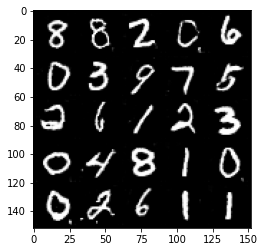

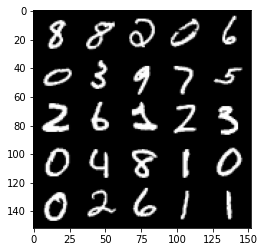

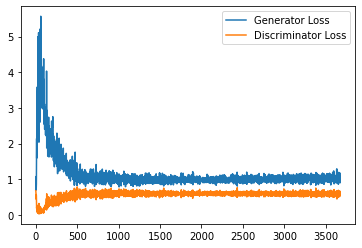

 78%|███████▊  | 365/469 [00:11<00:03, 33.22it/s]

Step 74000: Generator loss: 1.0395501511096954, discriminator loss: 0.5813280254602432


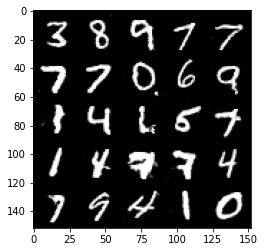

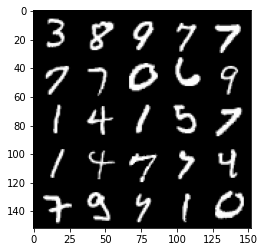

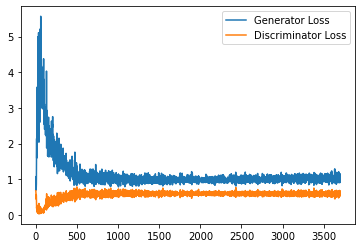

 84%|████████▍ | 396/469 [00:11<00:02, 34.06it/s]

Step 74500: Generator loss: 1.0227265512943269, discriminator loss: 0.5909960595369339


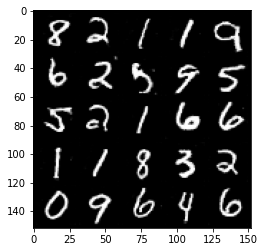

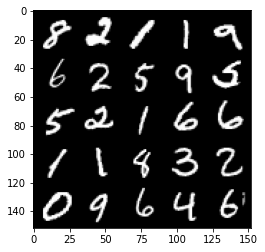

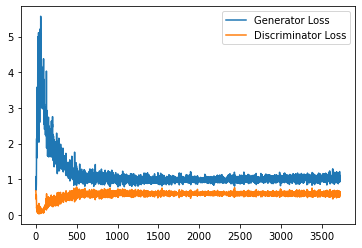

 91%|█████████▏| 428/469 [00:13<00:01, 32.01it/s]

Step 75000: Generator loss: 1.05107229077816, discriminator loss: 0.5837700757980346


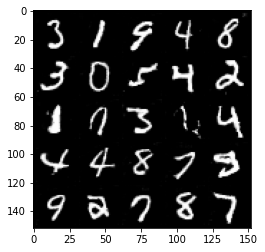

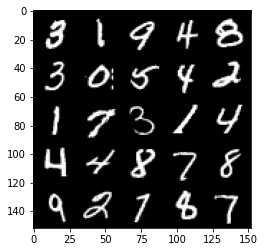

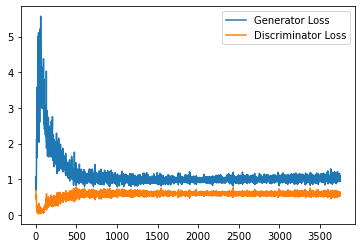

 97%|█████████▋| 457/469 [00:14<00:00, 33.40it/s]

Step 75500: Generator loss: 1.0272925355434417, discriminator loss: 0.5844616659879684


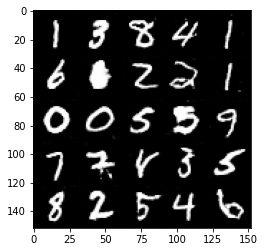

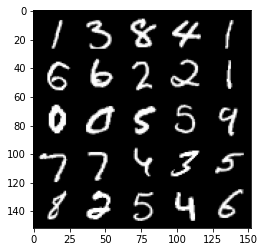

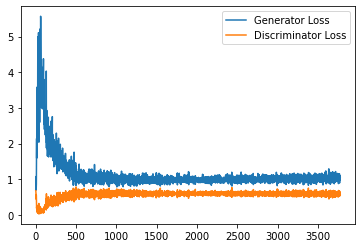

  4%|▍         | 21/469 [00:00<00:11, 38.00it/s]

Step 76000: Generator loss: 1.0333024482727051, discriminator loss: 0.5887699234485626


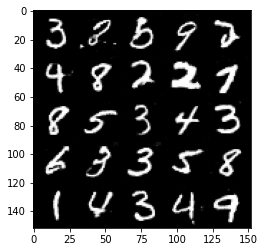

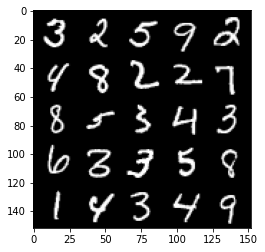

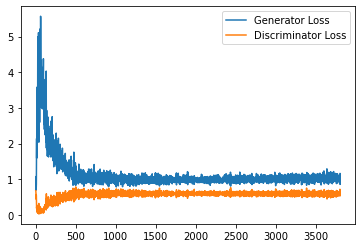

 11%|█         | 52/469 [00:01<00:12, 32.78it/s]

Step 76500: Generator loss: 1.0335764495134354, discriminator loss: 0.5837872752547264


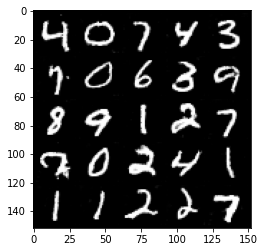

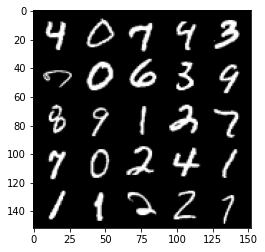

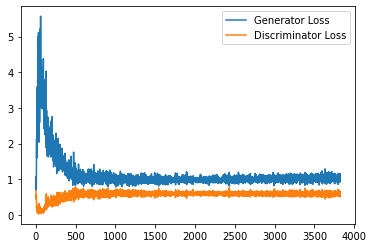

 17%|█▋        | 82/469 [00:02<00:14, 26.32it/s]

Step 77000: Generator loss: 1.030995224714279, discriminator loss: 0.5884026228785515


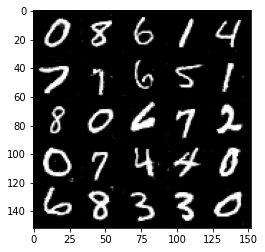

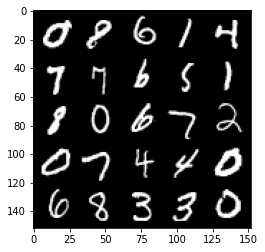

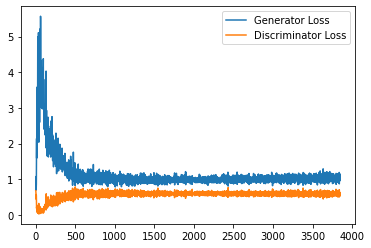

 24%|██▍       | 114/469 [00:03<00:10, 33.81it/s]

Step 77500: Generator loss: 1.035404237985611, discriminator loss: 0.5851526222825051


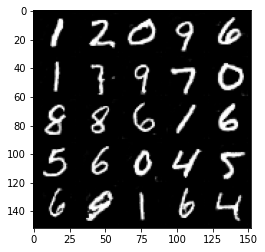

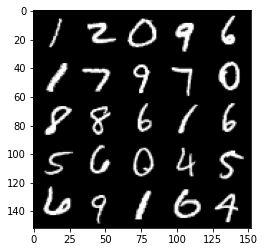

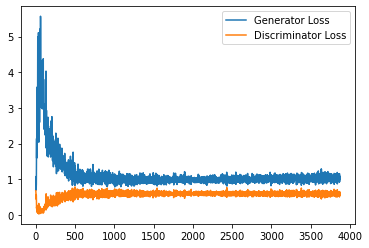

 31%|███       | 145/469 [00:04<00:09, 34.56it/s]

Step 78000: Generator loss: 1.053152198433876, discriminator loss: 0.5847419880032539


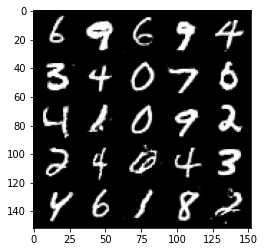

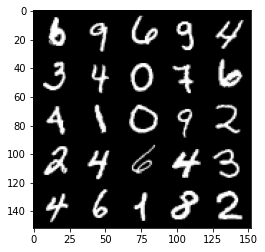

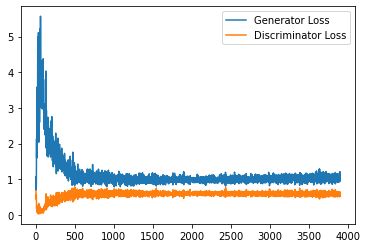

 38%|███▊      | 177/469 [00:05<00:08, 35.04it/s]

Step 78500: Generator loss: 1.0252778350114822, discriminator loss: 0.5854899734258652


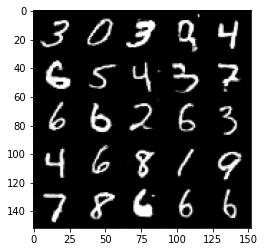

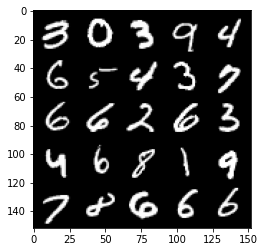

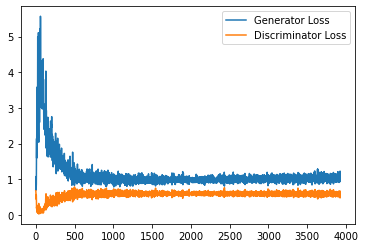

 43%|████▎     | 204/469 [00:06<00:08, 32.04it/s]

Step 79000: Generator loss: 1.0260412287712097, discriminator loss: 0.5913158671855927


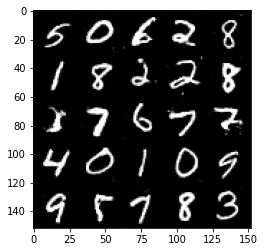

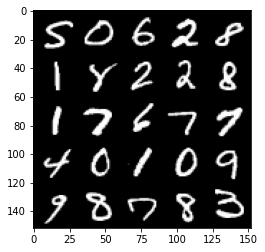

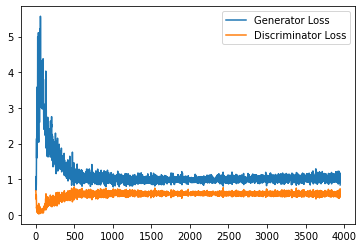

 51%|█████     | 237/469 [00:07<00:06, 33.55it/s]

Step 79500: Generator loss: 1.0561877847909928, discriminator loss: 0.5871230174303055


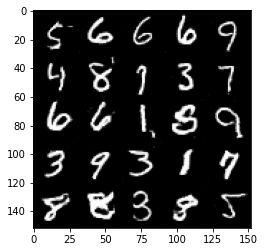

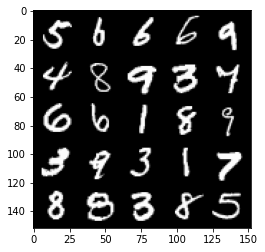

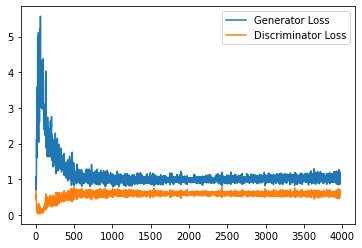

 57%|█████▋    | 269/469 [00:08<00:06, 30.88it/s]

Step 80000: Generator loss: 1.021614588737488, discriminator loss: 0.5884669216871261


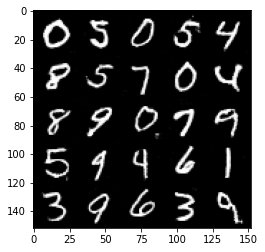

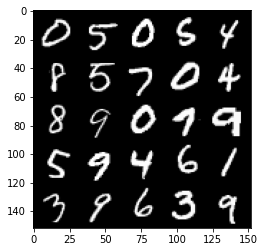

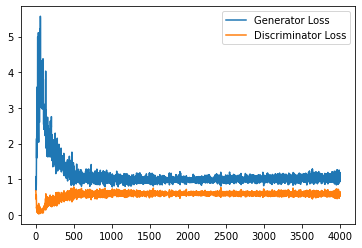

 64%|██████▍   | 299/469 [00:08<00:05, 33.62it/s]

Step 80500: Generator loss: 1.0488181874752045, discriminator loss: 0.5834756820201874


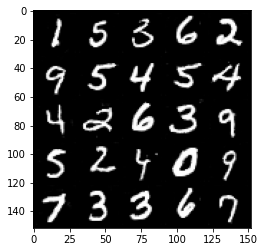

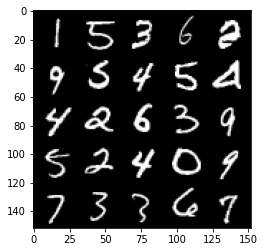

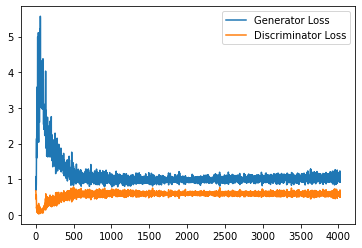

 70%|███████   | 330/469 [00:09<00:04, 33.45it/s]

Step 81000: Generator loss: 1.0225088069438935, discriminator loss: 0.5880171210169792


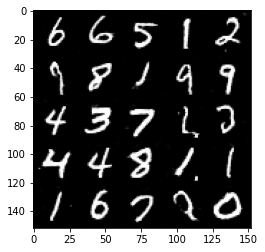

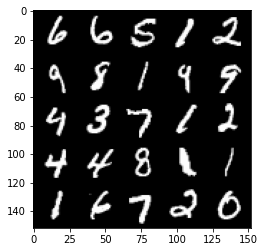

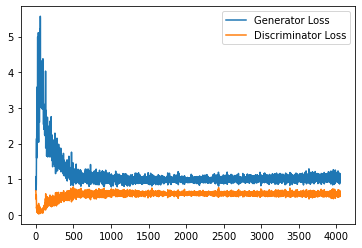

 77%|███████▋  | 360/469 [00:10<00:03, 36.08it/s]

Step 81500: Generator loss: 1.0246681743860244, discriminator loss: 0.5872812500596046


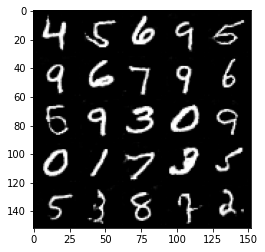

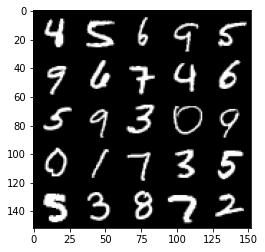

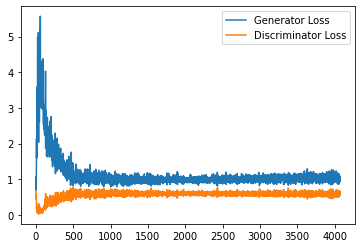

 84%|████████▍ | 394/469 [00:11<00:02, 34.85it/s]

Step 82000: Generator loss: 1.0599149749279022, discriminator loss: 0.5904548437595367


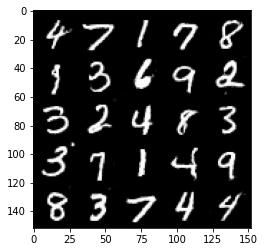

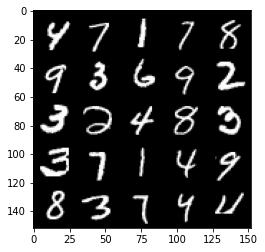

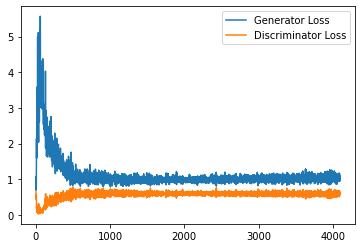

 91%|█████████ | 425/469 [00:12<00:01, 34.10it/s]

Step 82500: Generator loss: 1.0581442141532897, discriminator loss: 0.5858870103359223


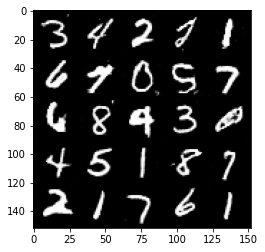

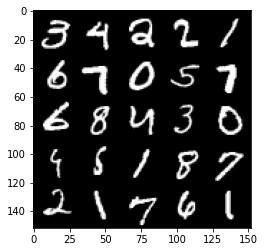

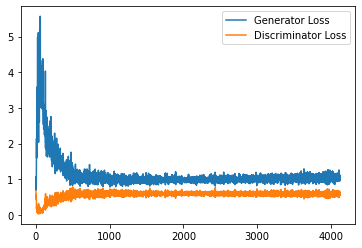

 97%|█████████▋| 453/469 [00:13<00:00, 34.41it/s]

Step 83000: Generator loss: 1.03617311501503, discriminator loss: 0.5923359676599502


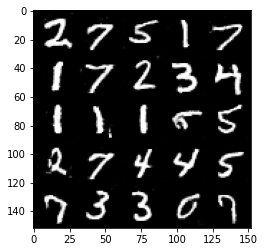

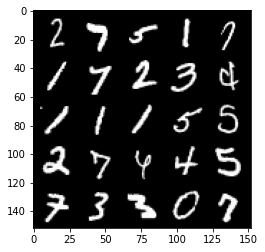

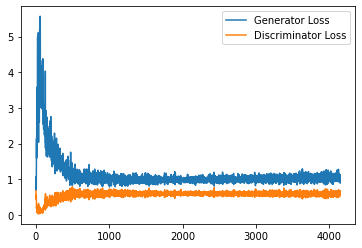

  3%|▎         | 16/469 [00:00<00:13, 34.18it/s]

Step 83500: Generator loss: 1.0199790081977844, discriminator loss: 0.5884907985925675


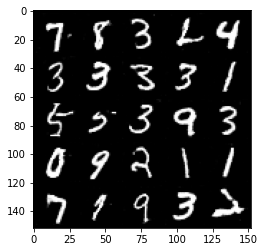

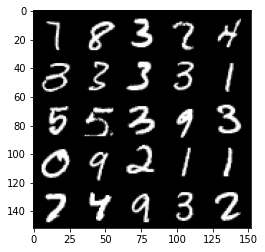

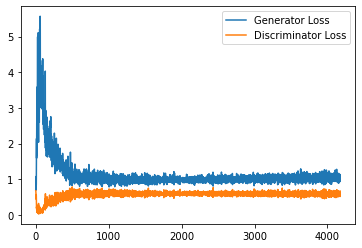

 10%|█         | 48/469 [00:01<00:12, 34.31it/s]

Step 84000: Generator loss: 1.0364697632789612, discriminator loss: 0.58646781873703


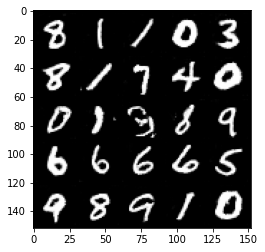

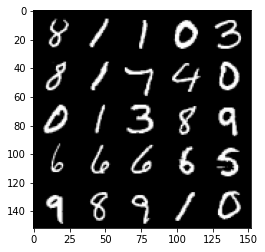

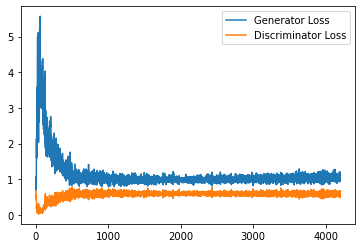

 17%|█▋        | 80/469 [00:02<00:11, 33.16it/s]

Step 84500: Generator loss: 1.0387205410003661, discriminator loss: 0.5878178334236145


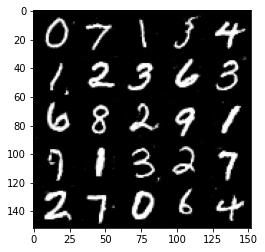

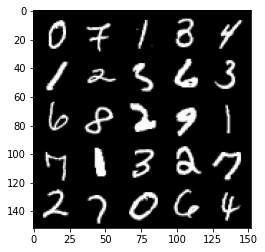

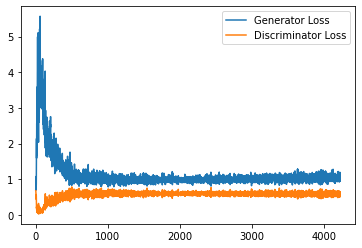

 23%|██▎       | 109/469 [00:03<00:10, 34.77it/s]

Step 85000: Generator loss: 1.0449749678373337, discriminator loss: 0.5834407840371132


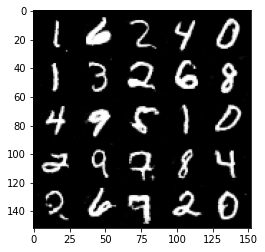

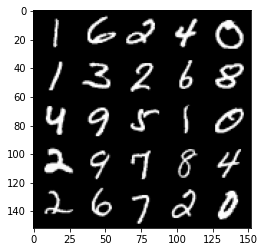

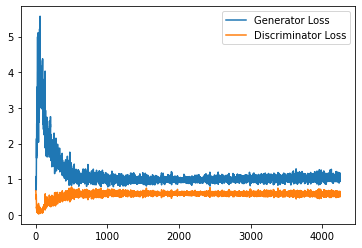

 30%|███       | 142/469 [00:04<00:10, 32.61it/s]

Step 85500: Generator loss: 1.0308398964405059, discriminator loss: 0.5885960394144059


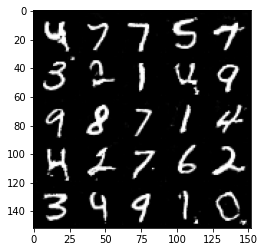

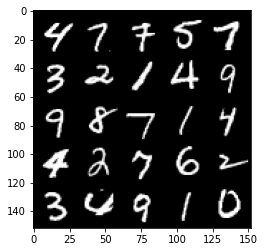

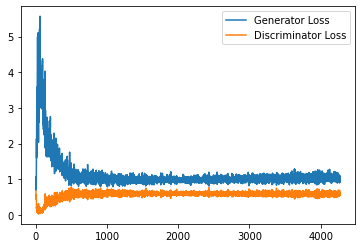

 37%|███▋      | 172/469 [00:05<00:08, 36.13it/s]

Step 86000: Generator loss: 1.0263615754842759, discriminator loss: 0.5915204756855965


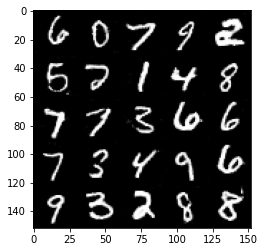

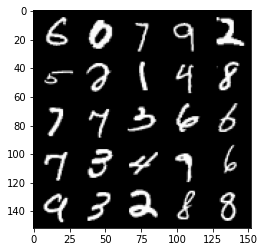

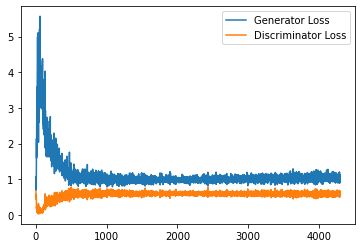

 43%|████▎     | 204/469 [00:06<00:07, 33.32it/s]

Step 86500: Generator loss: 1.026402475476265, discriminator loss: 0.5885853326320648


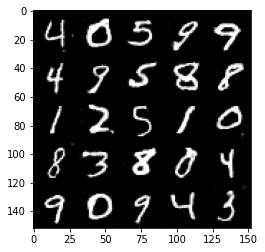

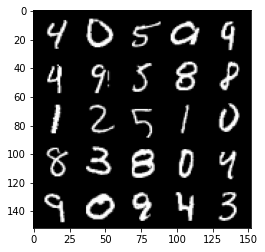

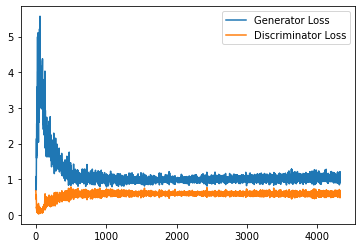

 50%|█████     | 235/469 [00:07<00:07, 33.35it/s]

Step 87000: Generator loss: 1.044963574409485, discriminator loss: 0.5902695482373238


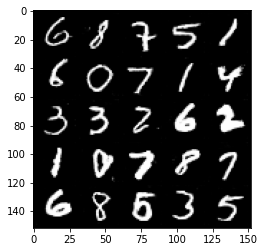

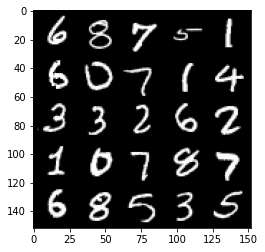

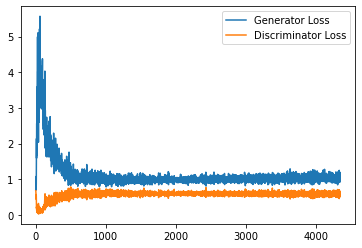

 57%|█████▋    | 266/469 [00:07<00:06, 33.05it/s]

Step 87500: Generator loss: 1.0351698771715163, discriminator loss: 0.5907166684269906


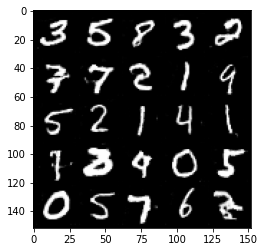

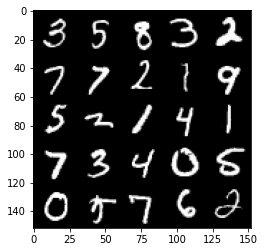

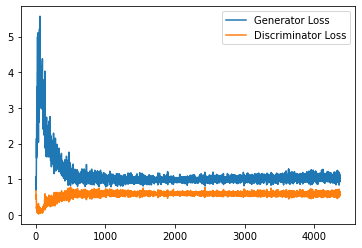

 63%|██████▎   | 296/469 [00:09<00:05, 33.41it/s]

Step 88000: Generator loss: 1.0393398787975312, discriminator loss: 0.5914979557991028


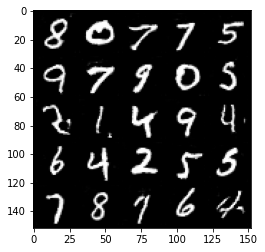

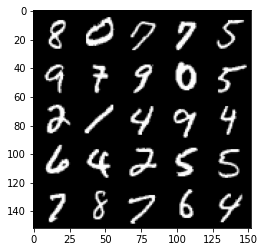

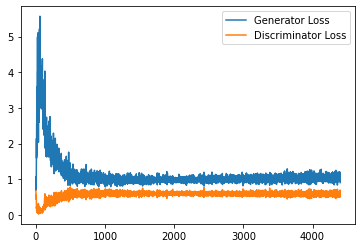

 69%|██████▉   | 325/469 [00:09<00:04, 33.62it/s]

Step 88500: Generator loss: 1.0486985630989074, discriminator loss: 0.5854846594333649


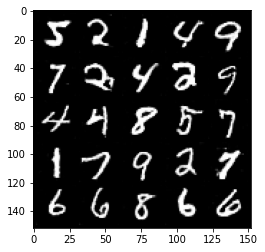

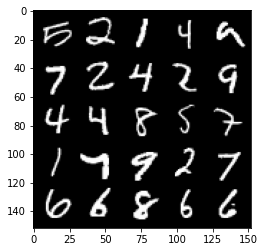

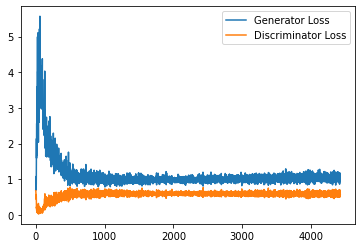

 76%|███████▋  | 358/469 [00:10<00:03, 29.63it/s]

Step 89000: Generator loss: 1.046351616501808, discriminator loss: 0.5956935166120529


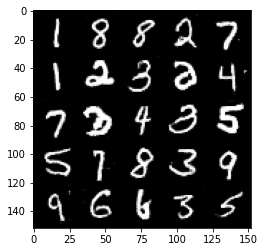

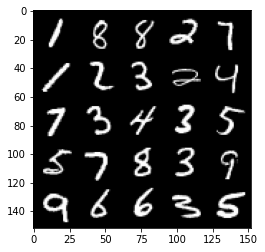

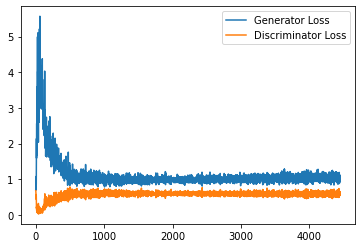

 83%|████████▎ | 390/469 [00:12<00:02, 28.61it/s]

Step 89500: Generator loss: 1.0374211474657058, discriminator loss: 0.5930092727541924


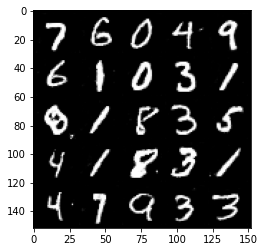

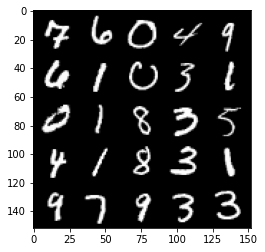

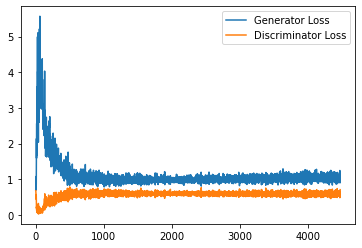

 90%|████████▉ | 421/469 [00:12<00:01, 32.98it/s]

Step 90000: Generator loss: 1.0369237744808197, discriminator loss: 0.5879702098369598


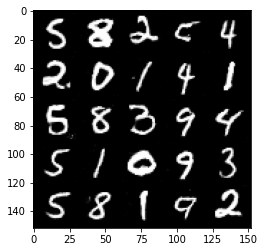

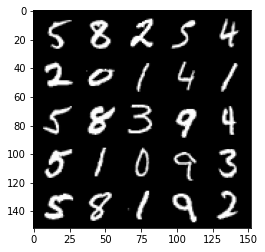

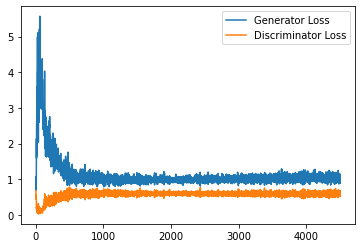

 96%|█████████▌| 450/469 [00:13<00:00, 33.10it/s]

Step 90500: Generator loss: 1.021558756351471, discriminator loss: 0.5948854611515999


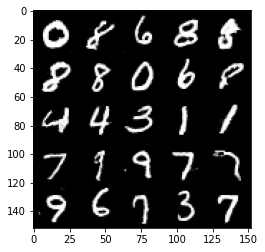

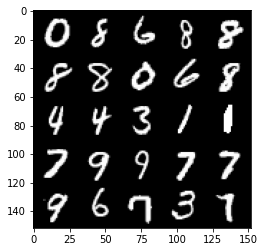

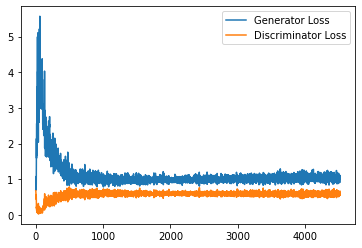

  3%|▎         | 12/469 [00:00<00:13, 33.50it/s]

Step 91000: Generator loss: 1.0479815726280213, discriminator loss: 0.5893835304379463


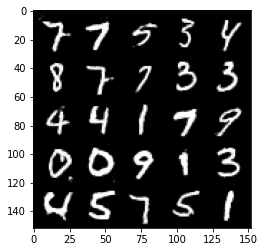

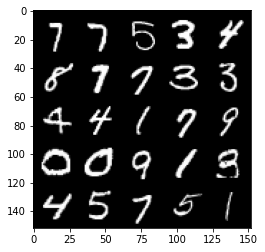

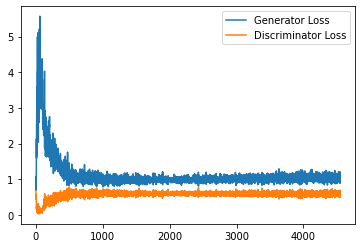

 10%|▉         | 45/469 [00:01<00:12, 34.01it/s]

Step 91500: Generator loss: 1.0265374649763108, discriminator loss: 0.5944696760773659


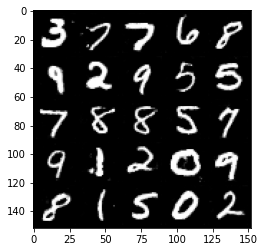

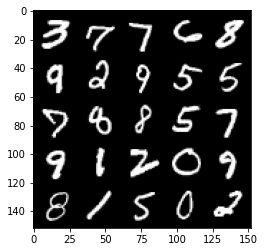

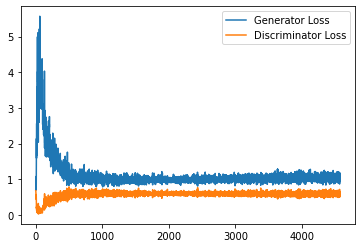

 16%|█▌        | 76/469 [00:02<00:11, 33.48it/s]

Step 92000: Generator loss: 1.02062832736969, discriminator loss: 0.5922749343514443


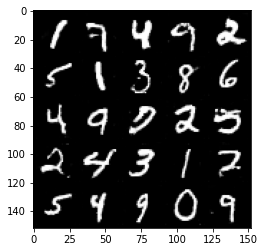

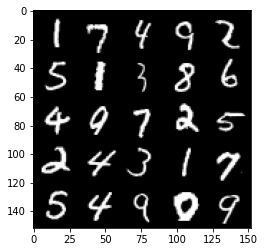

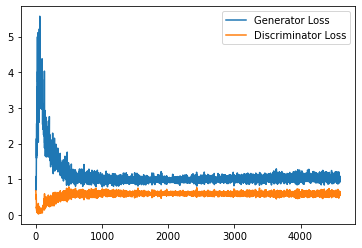

 22%|██▏       | 104/469 [00:03<00:10, 33.43it/s]

Step 92500: Generator loss: 1.0280613127946854, discriminator loss: 0.5911045706868172


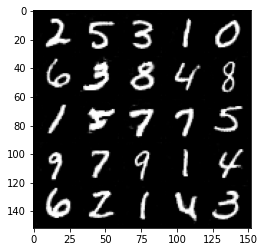

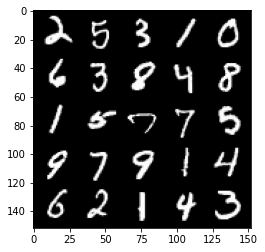

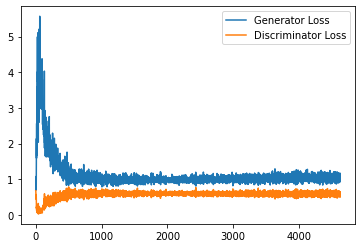

 29%|██▉       | 138/469 [00:04<00:10, 31.71it/s]

Step 93000: Generator loss: 1.0267016764879227, discriminator loss: 0.5965705680251121


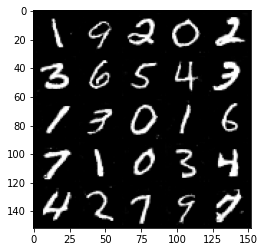

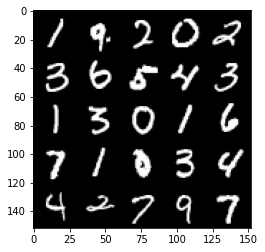

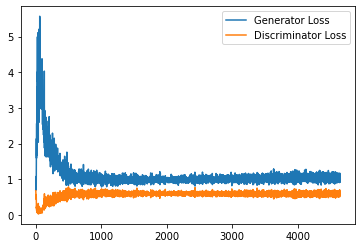

 36%|███▌      | 169/469 [00:05<00:08, 34.10it/s]

Step 93500: Generator loss: 1.037469864487648, discriminator loss: 0.5979438878893852


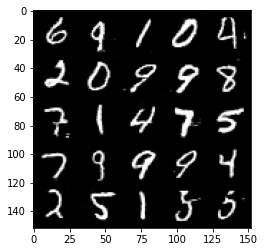

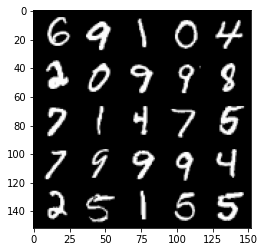

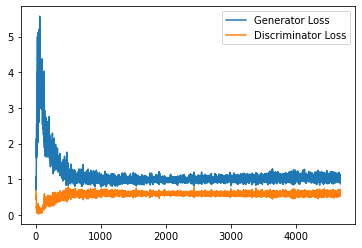

100%|██████████| 469/469 [00:14<00:00, 32.34it/s]


In [34]:
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)

        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1